
# Embedding, Clustering & Annotation - Endocrine Cells
Michael Sterr

2021-06-09 14:38:16      


# Setup

Run following scripts before:
 * scRNA-seq_iPSC_IIR-KO_Embedding-Clustering-Annotation_S6-Only_All-Cells.ipynb

In [1]:
#from IPython.core.display import display, HTML
#display(HTML("<style>.container { width:85% !important; }</style>"))

In [2]:
# General
import scipy as sci
import numpy as np
import pandas as pd
import logging
import time
import pickle
from itertools import chain
import anndata as ad
import gc # Free memory #gc.collect()

#R
#import rpy2
#import rpy2.rinterface_lib.callbacks
#from rpy2.robjects import pandas2ri
#import anndata2ri

# # Plotting
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.colors as mcolors
from matplotlib import rcParams
from matplotlib import cm
import seaborn as sb
#from plotnine import *

# # Analysis
import scanpy as sc
import scanpy.external as sce
#import scvelo as scv
#import cellrank as cr

In [3]:
import rpy2
import rpy2.rinterface_lib.callbacks


In [4]:
# Settings

## Scanpy settings
sc.settings.verbosity = 3
#sc.logging.print_versions()

## Scanpy settings
#scv.settings.verbosity = 3
#scv.logging.print_versions()

## Cell Rank settings
#cr.settings.verbosity = 2

## R settings
### Ignore R warning messages
#### Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

### Automatically convert rpy2 outputs to pandas dataframes
#pandas2ri.activate()
#anndata2ri.activate()
#%load_ext rpy2.ipython

#pd.set_option('display.height', 1000)
pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', 50)
#pd.set_option('display.width', 1000)

# Color Maps

In [5]:
from matplotlib.colors import ListedColormap
# Color maps4
#exec(open("/home/michi/Software/viscm/maps/michi_wt_rd_4.py").read())
#exec(open("/home/michi/Software/viscm/maps/dense.py").read())
#exec(open("/home/michi/Software/viscm/maps/turbo.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_bl_gn_yl.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_or.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_or_2.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_yl.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_yl_2.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_yl_3.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_rd_yl_4.py").read())
#exec(open("/home/michi/Software/viscm/maps/michi_bk_bl_gn.py").read())

ch_YlRd=sb.cubehelix_palette(100, start=.7, rot=.25, gamma=0.6, hue=2, light=1, dark=0.05, as_cmap=True)
ch_Bl=sb.cubehelix_palette(100, start=2.65, rot=0, gamma=0.8, hue=1.8, light=1, dark=0, as_cmap=True)
ch_Bl2=sb.cubehelix_palette(100, start=2.75, rot=-.12, gamma=0.8, hue=1.8, light=1, dark=0, as_cmap=True)
ch_Bl2_2=sb.cubehelix_palette(100, start=2.75, rot=-.12, gamma=0.8, hue=1.8, light=0.9, dark=0, as_cmap=True) #

cm_PuGy=ListedColormap(['#ededed', '#ecebec', '#eae9eb', '#e9e7eb', '#e8e5ea', '#e7e4e9', '#e5e2e8', '#e4e0e7', '#e3dee6', '#e1dce6', '#e0dae5', '#dfd8e4', '#ded7e3', '#dcd5e2', '#dbd3e1', '#dad1e1', '#d8cfe0', '#d7cddf', '#d6cbde', '#d5cadd', '#d3c8dc', '#d2c6dc', '#d1c4db', '#cfc2da', '#cec0d9', '#cdbfd8', '#ccbdd7', '#cabbd7', '#c9b9d6', '#c8b7d5', '#c6b5d4', '#c5b4d3', '#c4b2d2', '#c3b0d2', '#c1aed1', '#c0acd0', '#bfabcf', '#bda9ce', '#bca7cd', '#bba5cd', '#b9a3cc', '#b8a2cb', '#b7a0ca', '#b69ec9', '#b49cc8', '#b39ac8', '#b299c7', '#b097c6', '#af95c5', '#ae93c4', '#ac92c3', '#ab90c2', '#aa8ec2', '#a88cc1', '#a78bc0', '#a689bf', '#a487be', '#a385bd', '#a283bd', '#a182bc', '#9f80bb', '#9e7eba', '#9d7db9', '#9b7bb8', '#9a79b8', '#9977b7', '#9776b6', '#9674b5', '#9572b4', '#9370b3', '#926fb3', '#916db2', '#8f6bb1', '#8e69b0', '#8d68af', '#8b66ae', '#8a64ad', '#8863ad', '#8761ac', '#865fab', '#845daa', '#835ca9', '#825aa8', '#8058a8', '#7f57a7', '#7e55a6', '#7c53a5', '#7b52a4', '#7950a3', '#784ea2', '#774ca2', '#754ba1', '#7449a0', '#72479f', '#71469e', '#70449d', '#6e429d', '#6d409c', '#6b3f9b', '#6a3d9a'])
cm_YlBl=ListedColormap(['#ff7f0e', '#fe7f13', '#fc7f17', '#fb7f1a', '#fa7f1d', '#f87f20', '#f77f23', '#f57f26', '#f47f28', '#f37f2a', '#f17f2d', '#f07f2f', '#ee7f31', '#ed7f33', '#ec7f35', '#ea7f37', '#e97e39', '#e77e3b', '#e67e3d', '#e47e3e', '#e37e40', '#e27e42', '#e07e44', '#df7e45', '#dd7e47', '#dc7e49', '#da7e4a', '#d97e4c', '#d77e4e', '#d67e4f', '#d47e51', '#d37e52', '#d17e54', '#d07e55', '#ce7d57', '#cd7d59', '#cb7d5a', '#ca7d5c', '#c87d5d', '#c67d5f', '#c57d60', '#c37d62', '#c27d63', '#c07d64', '#be7d66', '#bd7d67', '#bb7d69', '#b97c6a', '#b87c6c', '#b67c6d', '#b47c6f', '#b37c70', '#b17c71', '#af7c73', '#ad7c74', '#ac7c76', '#aa7c77', '#a87c79', '#a67c7a', '#a47b7b', '#a37b7d', '#a17b7e', '#9f7b80', '#9d7b81', '#9b7b82', '#997b84', '#977b85', '#957b86', '#937b88', '#917a89', '#8e7a8b', '#8c7a8c', '#8a7a8d', '#887a8f', '#867a90', '#837a92', '#817a93', '#7e7a94', '#7c7996', '#797997', '#777998', '#74799a', '#71799b', '#6f799d', '#6c799e', '#69799f', '#6679a1', '#6278a2', '#5f78a3', '#5c78a5', '#5878a6', '#5478a8', '#5078a9', '#4c78aa', '#4878ac', '#4378ad', '#3d77ae', '#3777b0', '#3177b1', '#2977b3', '#1f77b4'])
cm_GnBl=ListedColormap(['#ffffff', '#fbfdfa', '#f7fcf6', '#f3faf2', '#eff8ef', '#ebf6eb', '#e7f4e8', '#e3f3e5', '#dff1e2', '#dbefde', '#d8eddb', '#d4ebd8', '#d0e9d5', '#cce7d2', '#c8e5cf', '#c5e3cf', '#c2e1ce', '#bfdfce', '#bcdccd', '#b9dacd', '#b6d8cd', '#b3d5cc', '#b0d3cb', '#add1cb', '#aaceca', '#a8ccca', '#a5cac9', '#a2c7c8', '#9fc5c8', '#9cc3c7', '#99c1c6', '#97bec5', '#94bcc5', '#91bac4', '#8eb7c3', '#8cb5c2', '#89b3c1', '#86b1c1', '#84aec0', '#81acbf', '#7eaabe', '#7ca7bd', '#79a5bc', '#77a3bb', '#74a1ba', '#729eb9', '#6f9cb8', '#6d9ab7', '#6a98b5', '#6895b4', '#6593b3', '#6391b2', '#608fb1', '#5e8db0', '#5c8aae', '#5988ad', '#5786ac', '#5584ab', '#5281a9', '#507fa8', '#4e7da7', '#4b7ba5', '#4979a4', '#4776a3', '#4574a1', '#4372a0', '#40709e', '#3e6e9d', '#3c6b9c', '#3a699a', '#386799', '#366597', '#346396', '#326194', '#305e92', '#2e5c91', '#2c5a8f', '#2a588e', '#28568c', '#26548b', '#245289', '#225087', '#204d86', '#1e4b84', '#1c4982', '#1a4781', '#18457f', '#16437d', '#14417b', '#123f7a', '#103d78', '#0e3b76', '#0c3974', '#0a3772', '#083571', '#06336f', '#04316d', '#032f6b', '#012d69', '#002a67'])
cm_Bl=ListedColormap(['#ffffff', '#fbfdfc', '#f7fbfb', '#f4f9f9', '#f0f7f8', '#ecf5f7', '#e9f3f5', '#e5f1f4', '#e2eff3', '#deedf2', '#daebf1', '#d7e9f0', '#d3e7ef', '#cfe5ee', '#cce3ed', '#c8e1ec', '#c4dfeb', '#c1ddea', '#bddbe9', '#b9d9e8', '#b6d7e7', '#b2d5e6', '#aed3e5', '#abd1e4', '#a7cfe3', '#a3cde2', '#9fcbe1', '#9cc8e0', '#9ac6df', '#97c4de', '#95c2dd', '#92bfdc', '#90bddb', '#8ebbda', '#8bb8d8', '#89b6d7', '#86b4d6', '#84b2d5', '#82afd4', '#7fadd2', '#7dabd1', '#7ba9d0', '#78a6cf', '#76a4cd', '#73a2cc', '#71a0cb', '#6f9ec9', '#6d9bc8', '#6a99c6', '#6897c5', '#6695c4', '#6393c2', '#6190c1', '#5f8ebf', '#5d8cbe', '#5a8abc', '#5888bb', '#5686b9', '#5483b8', '#5281b6', '#4f7fb5', '#4d7db3', '#4b7bb2', '#4979b0', '#4777ae', '#4575ad', '#4272ab', '#4070a9', '#3e6ea8', '#3c6ca6', '#3a6aa4', '#3868a3', '#3666a1', '#34649f', '#32629d', '#30609b', '#2e5e9a', '#2c5c98', '#2a5a96', '#285794', '#265592', '#245390', '#23518e', '#214f8c', '#1f4d8a', '#1d4b88', '#1b4986', '#1a4784', '#184582', '#164380', '#14417e', '#133f7c', '#113e7a', '#103c78', '#0e3a76', '#0d3874', '#0b3672', '#0a346f', '#09326d', '#08306b'])
cm_BlBk=ListedColormap(['#ffffff', '#fbfcfe', '#f6fafd', '#f2f7fc', '#eef4fa', '#eaf1f9', '#e6eff8', '#e1ecf6', '#dde9f5', '#d9e7f4', '#d5e4f2', '#d1e1f1', '#cddff0', '#c9dcee', '#c4d9ed', '#c0d7ec', '#bcd4ea', '#b8d1e9', '#b4cfe8', '#afcce6', '#abc9e5', '#a7c7e3', '#a3c4e2', '#9ec2e1', '#9abfdf', '#96bcde', '#91badc', '#8db7db', '#89b5da', '#84b2d8', '#80b0d7', '#7badd5', '#76aad4', '#72a8d2', '#6da5d1', '#68a3d0', '#63a0ce', '#5e9ecd', '#589bcb', '#5399ca', '#4d96c9', '#4794c7', '#4291c5', '#408ec3', '#3f8cc0', '#3e89bd', '#3c86bb', '#3b83b8', '#3a80b5', '#397db3', '#377bb0', '#3678ad', '#3575aa', '#3472a7', '#3270a4', '#316da2', '#306a9f', '#2f679c', '#2e6599', '#2d6296', '#2c5f93', '#2a5d90', '#295a8d', '#28588a', '#275586', '#265283', '#255080', '#244d7d', '#234b7a', '#234876', '#224673', '#214470', '#20416d', '#1f3f69', '#1e3c66', '#1e3a62', '#1d385f', '#1c355c', '#1b3358', '#1b3155', '#1a2e51', '#192c4d', '#182a4a', '#182846', '#172642', '#16233f', '#16213b', '#151f37', '#141d34', '#131b30', '#12192c', '#121728', '#111524', '#101320', '#0e101c', '#0c0d19', '#090a14', '#06070f', '#030308', '#000000'])
cm_CatBl=mcolors.ListedColormap(['#ffffff', '#fdfdfe', '#fbfcfd', '#f9fbfc', '#f7f9fb', '#f5f8fa', '#f3f6f9', '#f1f5f8', '#eff3f7', '#edf2f6', '#ebf0f5', '#e9eff4', '#e7edf3', '#e6ecf2', '#e4eaf1', '#e2e9f0', '#e0e7f0', '#dee6ef', '#dce4ee', '#dae3ed', '#d8e1ec', '#d6e0eb', '#d4deea', '#d2dde9', '#d0dbe8', '#cedae7', '#ccd9e6', '#cad7e5', '#c8d6e4', '#c6d4e3', '#c4d3e2', '#c2d1e1', '#c0d0e0', '#bfcedf', '#bdcdde', '#bbccdd', '#b9cadc', '#b7c9db', '#b5c7da', '#b3c6d9', '#b1c4d8', '#afc3d8', '#adc2d7', '#abc0d6', '#a9bfd5', '#a7bdd4', '#a5bcd3', '#a3bad2', '#a1b9d1', '#9fb8d0', '#9db6cf', '#9bb5ce', '#99b3cd', '#97b2cc', '#95b1cb', '#93afca', '#92aec9', '#90acc8', '#8eabc7', '#8caac6', '#8aa8c5', '#88a7c5', '#86a5c4', '#84a4c3', '#82a3c2', '#80a1c1', '#7ea0c0', '#7c9fbf', '#7a9dbe', '#779cbd', '#759abc', '#7399bb', '#7198ba', '#6f96b9', '#6d95b8', '#6b94b7', '#6992b6', '#6791b5', '#6590b5', '#638eb4', '#608db3', '#5e8cb2', '#5c8ab1', '#5a89b0', '#5888af', '#5586ae', '#5385ad', '#5184ac', '#4f82ab', '#4c81aa', '#4a80a9', '#477ea8', '#457da7', '#427ca7', '#407aa6', '#3d79a5', '#3b78a4', '#3877a3', '#3575a2', '#3274a1'])
cm_CatYl=mcolors.ListedColormap(['#ffffff', '#fffefd', '#fffcfb', '#fffbf8', '#fffaf6', '#fff9f4', '#fff7f2', '#fff6f0', '#fff5ee', '#fff3ec', '#fff2e9', '#fff1e7', '#ffefe5', '#ffeee3', '#ffede1', '#ffecde', '#ffeadc', '#ffe9da', '#ffe8d8', '#ffe6d6', '#ffe5d4', '#ffe4d1', '#ffe2cf', '#ffe1cd', '#ffe0cb', '#ffdec9', '#ffddc6', '#fedcc4', '#fedbc2', '#fed9c0', '#fed8be', '#fed7bc', '#fed5ba', '#fdd4b8', '#fdd3b5', '#fdd2b3', '#fdd0b1', '#fdcfaf', '#fccead', '#fcccab', '#fccba9', '#fccaa7', '#fbc9a5', '#fbc7a2', '#fbc6a0', '#fbc59e', '#fac39c', '#fac29a', '#fac198', '#f9c096', '#f9be94', '#f9bd92', '#f8bc90', '#f8bb8e', '#f8b98c', '#f7b889', '#f7b787', '#f6b685', '#f6b483', '#f6b381', '#f5b27f', '#f5b07d', '#f5af7b', '#f4ae79', '#f4ad77', '#f3ab75', '#f3aa73', '#f2a971', '#f2a86f', '#f1a66d', '#f1a56b', '#f1a468', '#f0a366', '#f0a164', '#efa062', '#ef9f60', '#ee9e5e', '#ee9c5c', '#ed9b5a', '#ed9a58', '#ec9956', '#ec9754', '#eb9652', '#ea9550', '#ea944d', '#e9924b', '#e99149', '#e89047', '#e88f45', '#e78d43', '#e68c41', '#e68b3e', '#e58a3c', '#e5883a', '#e48738', '#e38635', '#e38533', '#e28331', '#e2822e', '#e1812c'])

In [6]:
# Plot settings
%matplotlib inline

## Directory
#sc.settings.figdir='/home/michi/Projects/scMultiome_NVF_Mouse-Pancreas-Development_E14.5_Notebooks/Figures'

## Plotting parameters
#rcParams['figure.figsize']=(20,20) #rescale figures
#sc.set_figure_params(scanpy=True, frameon=False, vector_friendly=False, color_map='tab10' ,transparent=True, dpi=150, dpi_save=300)
#sc.set_figure_params(scanpy=True, frameon=False, vector_friendly=False ,transparent=True, dpi=150, dpi_save=300)

## Font
#rcParams['font.family'] = 'sans-serif'
#rcParams['font.sans-serif'] = ['Source Sans 3']

## Grid & Ticks
#rcParams['grid.alpha'] = 0
#rcParams['xtick.bottom'] = True
#rcParams['ytick.left'] = True

## Embed font
#plt.rc('pdf', fonttype=42)

## Define new default settings
#plt.rcParamsDefault = plt.rcParams

sc.set_figure_params(scanpy=True, dpi=80, dpi_save=250,
                     frameon=False,
                     color_map="YlGnBu", format='pdf', transparent=False,
                     ipython_format='png2x', figsize=(8,8))

# Load Data

In [7]:
adata=sc.read('/Users/dominik.klein/data/E14-E15_adata_filtered_rmDoublets_sctNormalized_WNN_embedded_initialAnno_intermediate.h5ad')

In [8]:
# Load cell cycle genes

## KEGG cell cycle genes
cc_kegg = pd.read_table('/Users/dominik.klein/Downloads/KEGG_mmu_Cell_Cycle.txt').iloc[:,0].tolist()

## Cell cycle genes Regev lab (Tirosh et al. 2016, DOI: 10.1126/science.aad0501)
cc_genes_regev = [x.strip() for x in open('//Users/dominik.klein/Downloads/regev_cell_cycle_genes.txt')]

s_genes_regev = [gene.lower().capitalize() for gene in cc_genes_regev[:43]]
g2m_genes_regev = [gene.lower().capitalize() for gene in cc_genes_regev[43:]]

cc_genes_regev = [gene.lower().capitalize() for gene in cc_genes_regev]

## Cell cycle genes Macosko et al. 2015, https://doi.org/10.1016/j.cell.2015.05.002
#cc_genes_macosko = pd.read_table('/mnt/ssd/Resources/Macosko_cell_cycle_genes.txt', delimiter='\t')

#s_genes_macosko = [gene.lower().capitalize() for gene in list(cc_genes_macosko['S'].dropna())]
#g2m_genes_macosko = [gene.lower().capitalize() for gene in list(cc_genes_macosko['G2.M'].dropna())]
#m_genes_macosko = [gene.lower().capitalize() for gene in list(cc_genes_macosko['M'].dropna())]
#mg1_genes_macosko = [gene.lower().capitalize() for gene in list(cc_genes_macosko['M.G1'].dropna())]
#g1s_genes_macosko = [gene.lower().capitalize() for gene in list(cc_genes_macosko['IG1.S'].dropna())]

#cc_genes_macosko = s_genes_macosko + g2m_genes_macosko + m_genes_macosko + mg1_genes_macosko + g1s_genes_macosko

## Combine all
all_cc_genes = list(set(cc_kegg + cc_genes_regev))# + cc_genes_macosko))

In [9]:
# Marker genes mouse pancreas (pair-wise)
marker_genes_mouse = dict()
marker_genes_mouse['Mat. Acinar'] = ['Arhgdig','Ass1','Cckar','Cel','Cela1','Cldn10','Dhx34','Edem1','Edem2','Erp27','Fkbp11','Gamt','Gcat','Gstm1','Mt1','Nupr1','Pnliprp1','Rbpjl','Reep5','Serpini2','Spink1','Tmem97']
marker_genes_mouse['Trunk'] = ['Actb']
marker_genes_mouse['Prlf. Trunk'] = ['H2afz']
marker_genes_mouse['Ngn3 high EP'] = ['Btbd17','Cbfa2t3','Cotl1','Gadd45a','Hes6','Mtch1','Neurog3','Ppp1r14a','Smarcd2','Tmsb4x']
marker_genes_mouse['Fev+'] = ['Fev', 'Krt7']
marker_genes_mouse['Beta'] = ['1110008P14Rik', 'Gng12', 'Mafb', 'Papss2']
marker_genes_mouse['Alpha'] = ['BC048546', 'Peg10', 'Slc38a5', 'Tmem27', 'Ttr', 'Tmsb15l']
marker_genes_mouse['Delta'] = ['Cd24a', 'Hhex', 'Pyy', 'Rbp4', 'Sst']
marker_genes_mouse['Epsilon'] = ['Ghrl', 'Maged2', 'Mboat4']
marker_genes_mouse['Multipotent'] = ['Npm1', 'Ppia']
marker_genes_mouse['Acinar'] = ['Car9','Cbs', 'Cckar','Cel','Cela1','Cldn10','Edem1','Erp27','Gamt','Gcat','Gstm1','Igf1','Nupr1','Ptf1a','Rbpjl','Reep5','Serpini2','Tmem97']
marker_genes_mouse['primary Alpha'] = ['Sct', 'Slc38a5']
#marker_genes_mouse[] = []

# Marker genes mouse pancreas unique versus rest
marker_genes_mouse2 = dict()
marker_genes_mouse2['Multipotent'] = ['Eef2', 'Rpl38', 'Rpl22', 'Rpl7a', 'Eef1b2', 'Btf3', 'Gnb2l1', 'Pabpc1']
marker_genes_mouse2['Tip'] = ['Smco4', 'Bzw2', 'Gcsh', 'Nme4', 'Cpn1', 'Mpp6', 'Gpc3', 'Tcf15', 'Capn6', 'Nop56', 'Trp53', 'Sdc1', 'Afp', 'Cdca7', 'Hyal2', 'Nrp1', 'P2rx1', 'Ccnd2', 'Jam3', 'Myc', 'Prss23', 'Ccdc30', 'Trf', 'Tnfaip8', 'Gulo', 'Dkc1', 'Fermt1', 'Vtn', 'Cda', 'Fbl', 'Zfp503', 'Rhov', 'Gsto1', 'Acvr2b', 'Noxa1', 'Id3', 'Apoe', 'Chst2', 'Ogfrl1', 'Sdpr', 'Nipsnap1', 'Ung', 'Hmgb3', 'Ruvbl1', 'Sez6', 'Igf2bp1', 'Igfbp4', 'Frem2', 'Flrt2', 'Dcakd', 'Mest', 'Cdca7l', 'Ppif', 'Dctd', 'Atic', 'Paics', 'Fbln1', 'Kirrel2', 'Rcbtb2', 'Gc', 'Dusp9', 'Car14', 'Hmga1-rs1', 'Hmga1', 'Phgdh', 'Gnl3', 'Stmn1', 'Dctpp1', 'Gar1', 'Matn4', 'Serf1', 'Rcn3', 'Ruvbl2', 'Sept9', 'Fzd2', 'Wdr77', 'Trim28', 'Pltp', 'Bmp7', 'Igfbp2', 'Shmt1', 'Crabp1', 'Mcm7', 'Etv4', 'Prdx6', 'Fam60a', 'Pcbp4', 'Apex1', 'C1qbp', 'Rcan2']
marker_genes_mouse2['Prlf. Tip'] = ['Cdca7l', 'Ccnf', 'Mpp6', 'Nasp', 'Cdca4', 'Eme1', 'Rad51ap1', 'Ncaph', 'Ezh2', 'Cdca5', 'Skp2', 'Vrk1', 'Exo1', 'Ube2t', 'Dut', 'Hist1h2ae', 'Trip13', 'Kif22', 'Cenpn', 'Rrm1', 'Fam64a', 'Kif2c', 'Dscc1', 'Mns1', 'Aars', 'Pcna', 'Mcm7', 'Cenpw', 'Fignl1', 'Rcc1', 'Clspn']
marker_genes_mouse2['Trunk'] = ['mt-Co2', 'H2afz', 'Notch2', 'Hmgn1', 'Hnrnpa1', 'Rpgrip1', 'mt-Co3', 'mt-Nd1']
marker_genes_mouse2['Prlf. Trunk'] = ['Supt16', 'Hmgn2', 'Sumo2', 'Ran', 'Ranbp1', 'Hmgn1', 'Dynll1', 'Hnrnpa1', 'Rpgrip1', 'H2afz', 'Anp32b']
marker_genes_mouse2['Prlf. Acinar'] = ['Pigf', 'Suclg2', 'Pla1a', 'Akr1c13', 'Ddc', 'Uchl5', 'Add3', 'Pa2g4', 'Gart', 'Gata4', 'Galk1', 'Lyar', 'Tinag', 'Vars', 'Gar1', 'Tex30', 'Wdtc1', 'Ifrd2', 'Mthfd1', 'Pold2', 'Atad3a', 'Phlda1', 'Ptn', 'Igf2', 'Umps', 'Aldh1b1', 'Slc38a3', 'Plk2', 'Akap7']
marker_genes_mouse2['Mat. Acinar'] = ['Try10', 'Clps', 'Tram1', 'C1qa', 'Ssr1', 'Prss1', 'Dap', 'Tspan13', 'Atp5g1', 'Bhlha15', 'Car9', 'Cela3b', 'Bcat2', 'Ldha', 'Arhgdig', 'Dhrs7', 'Rexo2', 'Ssr4', 'Ass1', 'Ppib', 'Ang', 'Lgals1', 'Tob1', 'Fabp5', 'Ttc23', 'Sel1l', 'Lin37', 'Tmed3', 'P4hb', 'Pdia2', 'Ostc', 'Herpud1', 'Dnajc3', 'Tmem147', 'Clu', 'Rap1gap', 'Rps27l', 'Kctd14', 'Fkbp2', 'Serp1', 'Mlec', 'Sephs2', 'Sdf2l1', 'Edem1', 'Edem2', 'Krtcap2', 'Aqp8', 'Sepp1', 'Tmem238', 'Try5', 'Dhx34', 'Msrb1', 'Bckdk', 'Fam46c', 'Erp27', 'Vimp', 'Mrps24', 'Rrbp1', 'Gm15915', 'Cpb1', 'Rnase4', 'Fkbp11', 'Cela2a', 'Prss2']
marker_genes_mouse2['Ductal'] = ['Hpgd', 'Rassf10', 'Fmo2', 'Ugt2b34', 'Cdc42ep1', 'Gm266', 'Fjx1', 'Trip6', 'Slco3a1', 'Cited1', 'Cadm1', 'Gpt2', 'Rhob', 'Rxrg', 'Igsf3', 'Sphk1', 'Fam89a', 'Ctsh', 'Nrarp', 'Mycn', 'Tubb2b', 'Nav2', 'Ajuba', 'Ncald', 'Akr1cl', 'Eno1', 'S100a16', 'Cnn3']
marker_genes_mouse2['Prlf. Ductal'] = ['Kif11', '2700094K13Rik', 'Dnajc9', 'Ccdc34', 'Cited1', 'Slco3a1', 'Cadm1', 'Melk', 'Kif23', 'Kif20a', 'Nuf2', 'Nrarp', 'Tuba1c', 'Bub3', 'Mki67', 'Asf1b', 'Mxd3']
marker_genes_mouse2['Ngn3 low EP'] = ['Gas2', 'Fndc5', 'Dbi', 'Fabp3', 'Ptprf', 'Cxcl12', 'Tmem171', 'Fam159a', 'Igf1r', 'Nrtn', 'Crp', 'Grin3a', 'Trim47', 'Mia', 'Enpp2', 'Ndrg2', 'Slc28a3', 'Lamb1', 'Kcnk1', 'Zfhx3', 'Eps8l2', 'Gal3st1', 'Mesdc1', 'Slc2a2', 'Ckb', 'Rbms3', 'Krt18', 'Wapl', 'Anxa5']
marker_genes_mouse2['Ngn3 High early'] = ['Spsb4', 'Kdm1a', 'Pard3', 'Gm8773', 'Fgd2', 'Rasl11b', 'Enc1', 'Tpm4', 'Gtf2a2', 'Agap3', 'Sox11', 'Phc2', 'Lrrn2', 'Glrx3', 'Csnk1e', 'Ssbp3', 'Ppp1r14b', 'Plk3', 'Chd7', 'Steap1']
marker_genes_mouse2['Ngn3 High late'] = ['Ly6e', 'Ifitm2', 'Swt1', 'Hspa8', 'Rnf114', 'Traf4', 'Shf', 'Tpst2', 'Sulf2', 'Sult2b1', '2010107G23Rik', 'Prdx2', 'Eif3f']
marker_genes_mouse2['Fev+ Beta'] = ['Nisch', 'Clta', 'Npepl1', 'Cox7a2l']
marker_genes_mouse2['Beta'] = ['Papss2', 'Ins2', 'Mien1', 'Ece1', 'Nnat', 'Mlxipl', 'Entpd3', 'Gjd2', 'Atp6v1e1', 'Pcsk1', 'Sec61b', 'Immp1l', 'Pdx1', 'Atp2a2', 'Ociad2']
marker_genes_mouse2['Fev+ Alpha'] = ['Cd164l2', 'Dst', 'Irf2bpl', 'Gm43861', 'Gnai2', 'Pnmal1', 'Klhl7', 'Tekt2', 'Qdpr', 'Zwint']
marker_genes_mouse2['primary Alpha'] = ['Dnajc12', 'Asb4', 'Uqcc2', 'Ptprn', 'Wnk3', 'Cd81', 'Ly6h', 'Emc10', 'Edn3', 'Slc14a2', 'Ndufv3', 'Atp6v0e2', 'Dohh', 'Nudt11', 'Mapk15', 'Rab37', '2210013O21Rik', 'Ctsz', 'Nap1l5', 'Syt7', 'Tma7', 'Snrpn', 'Gm11716', 'Basp1', 'Sgce']
marker_genes_mouse2['secondary Alpha'] = ['Ncam1', 'Sphkap', 'Sez6l2', 'Ush1c']
marker_genes_mouse2['Alpha'] = ['Dnajc12', 'Irx1', 'Ttr', 'Ndn', 'Wnk3', 'Ncam1', 'Resp18', 'Sct', 'Gcg', 'BC048546', 'Tmsb15l', 'Efcab1', 'Tmsb15b2', 'Sphkap', 'Ush1c', 'Dock11']
marker_genes_mouse2['Fev+ Pyy'] = ['Gde1', 'Pgrmc1', 'Fam216a', 'Rsrp1', 'Mbnl2', 'Pou3f4', 'Usp18', 'Gprasp2']
marker_genes_mouse2['Fev+ Delta'] = ['Yipf4', 'Camk2n2', 'Ppp2r5b', 'B630019K06Rik', 'Dctn3']
marker_genes_mouse2['Fev+ Epsilon'] = ['Tmem184c', 'Psmc2', 'Spint1', 'Ubl3', 'Sdcbp', 'Pclo', 'Lpcat3', 'Hpca', 'Cer1', 'Drap1', 'Lrrc42', 'Ppp3ca', 'Abhd15']
marker_genes_mouse2['Delta'] = ['Pld3', 'Frzb', 'Auts2', 'Kcnmb2', 'Sst', 'Cd24a', 'Smim14', 'Manf', 'Spcs2', 'Fam46a', 'Th', 'Ramp1', 'PISD', 'Kctd8', 'Hadh', 'Ssr2', 'Ddost', 'Erp29', 'Fam159b', 'Ppp1r14c', 'Ywhaq']
marker_genes_mouse2['Epsilon'] = ['Maged2', 'Txndc12', 'Prdx5', 'Cd164', 'Gng4', 'Pnmal2', 'Card19', 'Fam174a', 'Gm11837', 'Lrrtm3', 'Sin3b', 'Alcam', 'Ghrl', 'Lamp1', 'Fhl2', 'Anpep', 'Rbpms', 'Atraid']


In [10]:
# marker genes from Bastidas-Ponce et al., 2019
marker_genes_mouse3=dict()
marker_genes_mouse3['Multipotent'] = ['MDK', 'Btf3', 'Dlk1']
marker_genes_mouse3['Tip'] = ["Cpa1","Myc", "Vtn", "Jam3"] # Cpa1 good marker
marker_genes_mouse3["Trunk"] = ["Notch2", "Hmgn1", "Ybx1"]
marker_genes_mouse3["Acinar"] = ["Ptf1a", "Cpa1", "Cel", "Rbpjl", 'Reep5']
marker_genes_mouse3["Ductal"] = ["Sox9", "Anxa2","Bicc1", "Spp1"]
marker_genes_mouse3["EP"] = ["Ngn3", "Hes6", "Btbd17", "Gadd45a"]
marker_genes_mouse3['Fev+'] = ["Fev", "Cck", "Neurod1", "Vwa5b2", "Tox3"]
marker_genes_mouse3['Endocrine'] = ["Rbp4", "Pyy","Chgb"]


In [11]:
init_clus_dict = {
    
    '0':['Prlf. Ductal', 'Ductal'],
    '1':['Ngn3 low EP', 'Ngn3 High early'],
    '2':['Prlf. Ductal', 'Multipotent', 'Ductal'],
    '3':['Fev+'],
    '4':['Ngn3 low EP'],
    '5':['Ngn3 High late'],
    '6':['Fev+ Beta'],
    '7':['Multipotent'],
    '8':['Beta', 'Fev+ Beta'],
    '9':['Multipotent', 'Ductal', 'Prlf. Ductal'],
    '10':['Prlf. Acinar', 'Mat. Acinar'],
    '11':['Fev+ Delta', 'Fev+ Epsilon', 'Epsilon', 'Delta'],
    '12':['Prlf. Ductal', 'Ductal'],
    '13':['Prlf. Ductal', 'Multipotent', 'Ductal'],
    '14':['Prlf. Acinar', 'Mat. Acinar'],
    '15':['Fev+ Alpha'],
    '16':['Ngn3 High cycling', 'Ngn3 High early', 'Ngn3 High late', 'Fev+'],
    '17':['Alpha'],
    '18':['Ngn3 High cycling', 'Ngn3 High early', 'Ngn3 High late', 'Fev+'],
    '19':['Ductal', 'Prlf. Ductal'],
}

Subcluster 12

In [12]:
c_id = 12

In [13]:
init_clus_dict[str(c_id)]

['Prlf. Ductal', 'Ductal']

In [14]:
orig_key = 'leiden_sub8'
new_key = 'leiden_sub9' 
new_rg_key = 'rg_sub9'
sub_key = str(c_id)

running Leiden clustering
    finished: found 36 clusters and added
    'leiden_sub9', the cluster labels (adata.obs, categorical) (0:00:00)


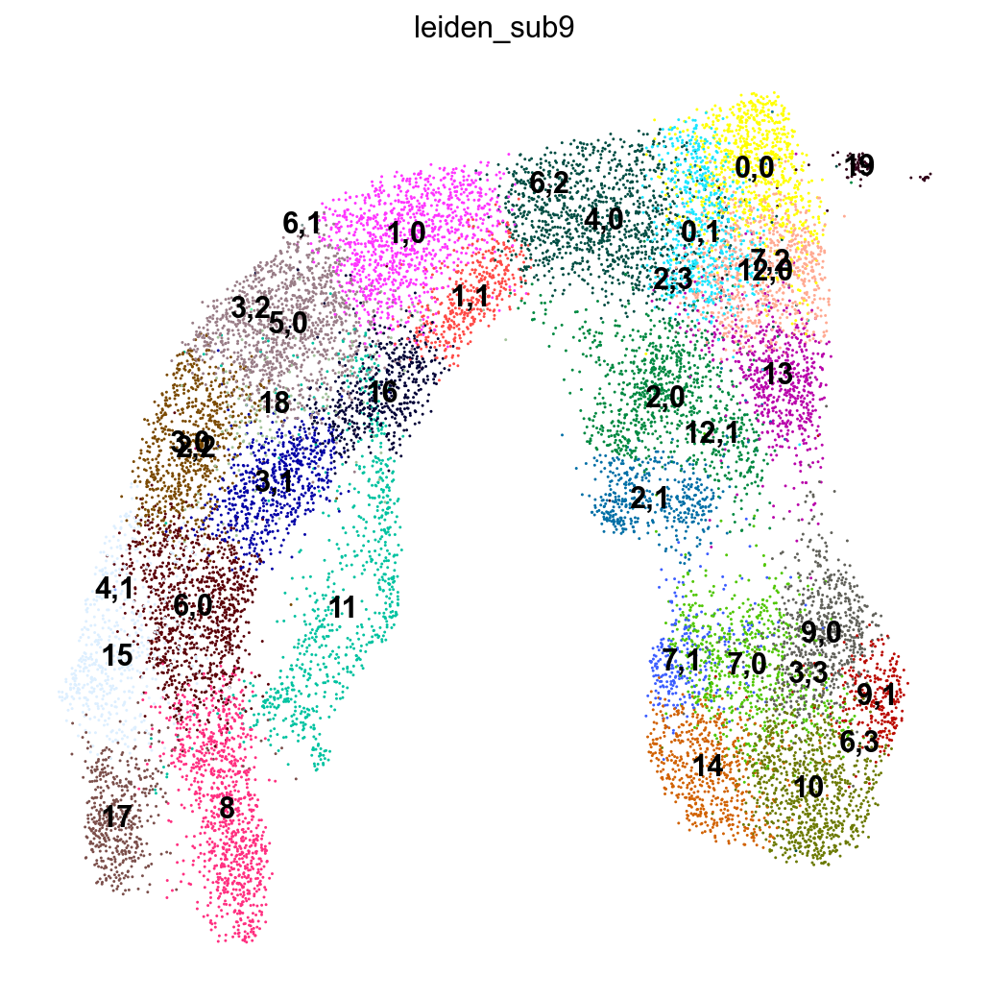

4,0     1161
5,0     1157
6,0     1017
1,0     1014
8        934
2,0      911
0,0      868
10       829
11       762
3,0      714
12,0     709
7,0      650
9,0      649
13       635
3,1      621
0,1      616
14       574
15       555
16       501
17       469
2,1      447
1,1      407
7,1      283
9,1      267
18       149
19        69
7,2        1
6,2        1
12,1       1
6,1        1
4,1        1
3,3        1
3,2        1
2,3        1
2,2        1
6,3        1
Name: leiden_sub9, dtype: int64

In [15]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub9']`
categories: 0,0, 0,1, 1,0, etc.
var_group_labels: Prlf. Ductal, Ductal


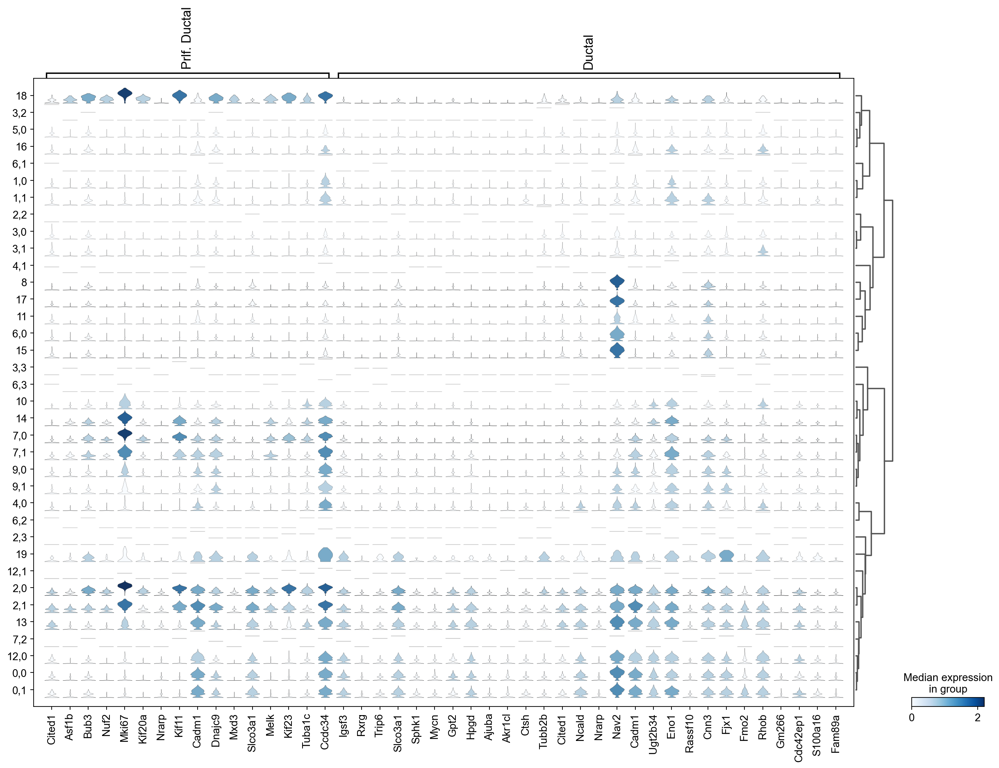

In [16]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Prlf. Ductal', 'Ductal']
}, groupby=new_key, dendrogram=True)

- 12,0 Ductal
- 12,1: low q


Subcluster 13

In [17]:
c_id = 13

In [18]:
init_clus_dict[str(c_id)]

['Prlf. Ductal', 'Multipotent', 'Ductal']

In [19]:
orig_key = 'leiden_sub9'
new_key = 'leiden_sub10' 
new_rg_key = 'rg_sub10'
sub_key = str(c_id)

running Leiden clustering
    finished: found 37 clusters and added
    'leiden_sub10', the cluster labels (adata.obs, categorical) (0:00:00)


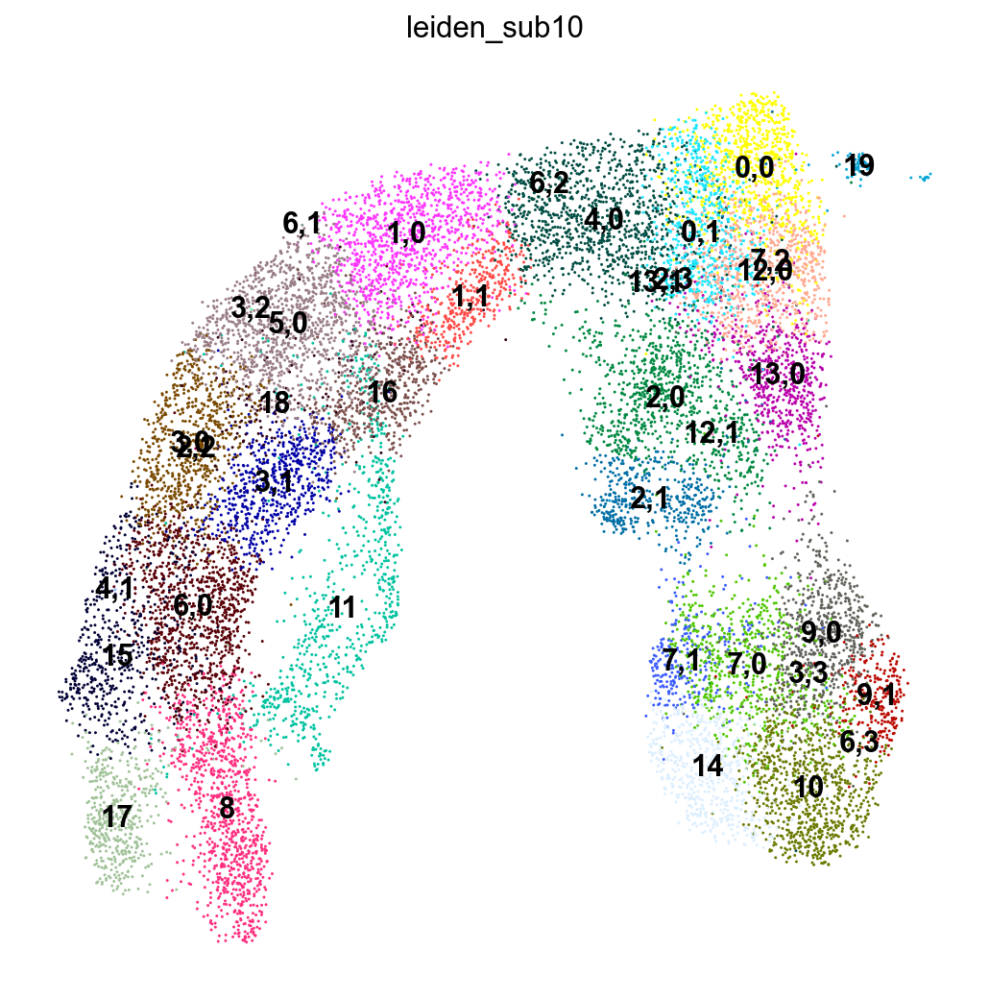

4,0     1161
5,0     1157
6,0     1017
1,0     1014
8        934
2,0      911
0,0      868
10       829
11       762
3,0      714
12,0     709
7,0      650
9,0      649
13,0     634
3,1      621
0,1      616
14       574
15       555
16       501
17       469
2,1      447
1,1      407
7,1      283
9,1      267
18       149
19        69
7,2        1
6,2        1
12,1       1
6,1        1
13,1       1
4,1        1
3,3        1
3,2        1
2,3        1
2,2        1
6,3        1
Name: leiden_sub10, dtype: int64

In [20]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

- 13,0 Ductal
- 13,1: low q


Subcluster 15

In [21]:
c_id = 15

In [22]:
init_clus_dict[str(c_id)]

['Fev+ Alpha']

In [23]:
orig_key = 'leiden_sub10'
new_key = 'leiden_sub11' 
new_rg_key = 'rg_sub11'
sub_key = str(c_id)

running Leiden clustering
    finished: found 38 clusters and added
    'leiden_sub11', the cluster labels (adata.obs, categorical) (0:00:00)


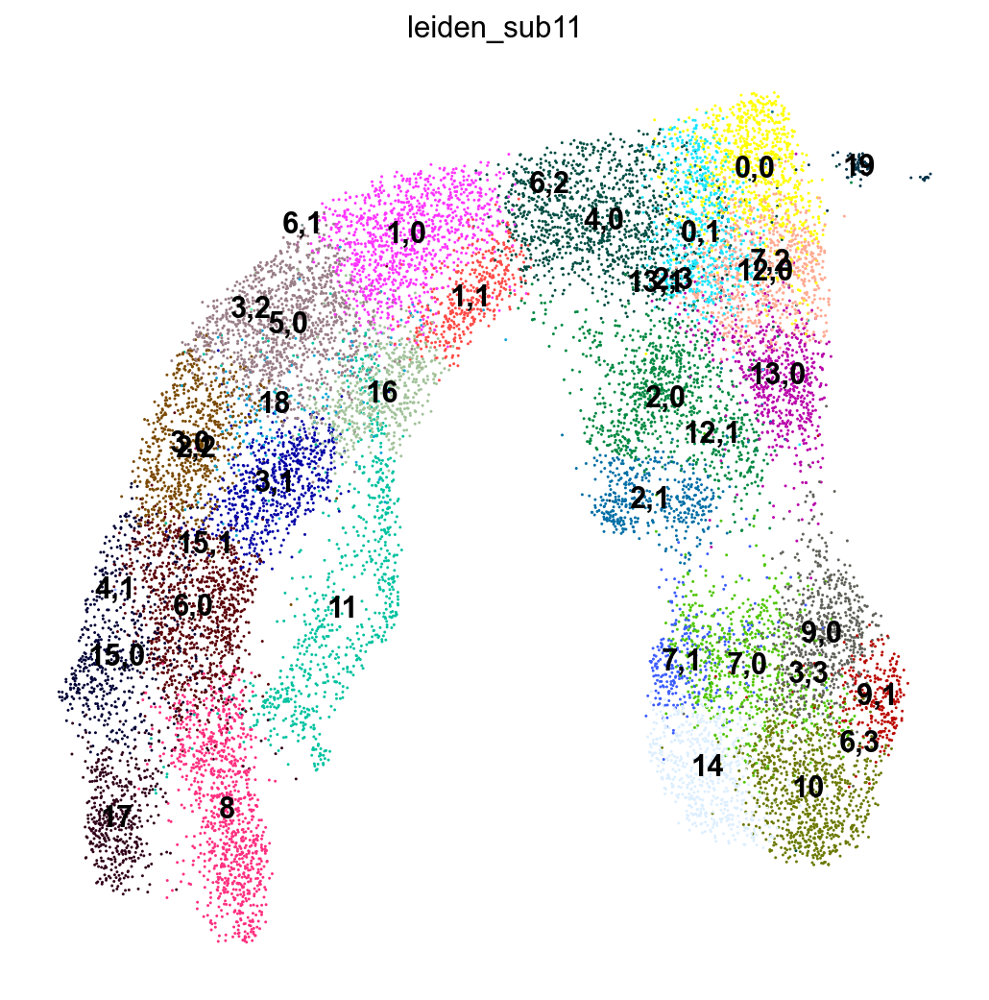

4,0     1161
5,0     1157
6,0     1017
1,0     1014
8        934
2,0      911
0,0      868
10       829
11       762
3,0      714
12,0     709
7,0      650
9,0      649
13,0     634
3,1      621
0,1      616
14       574
15,0     554
16       501
17       469
2,1      447
1,1      407
7,1      283
9,1      267
18       149
19        69
15,1       1
13,1       1
3,3        1
12,1       1
4,1        1
2,3        1
7,2        1
6,3        1
6,2        1
6,1        1
3,2        1
2,2        1
Name: leiden_sub11, dtype: int64

In [24]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

- 15,0: Fev+ Alpha
- 15,1: low q



Subcluster 18

In [25]:
c_id = 18

In [26]:
init_clus_dict[str(c_id)]

['Ngn3 High cycling', 'Ngn3 High early', 'Ngn3 High late', 'Fev+']

In [27]:
orig_key = 'leiden_sub11'
new_key = 'leiden_sub12' 
new_rg_key = 'rg_sub12'
sub_key = str(c_id)

running Leiden clustering
    finished: found 41 clusters and added
    'leiden_sub12', the cluster labels (adata.obs, categorical) (0:00:00)


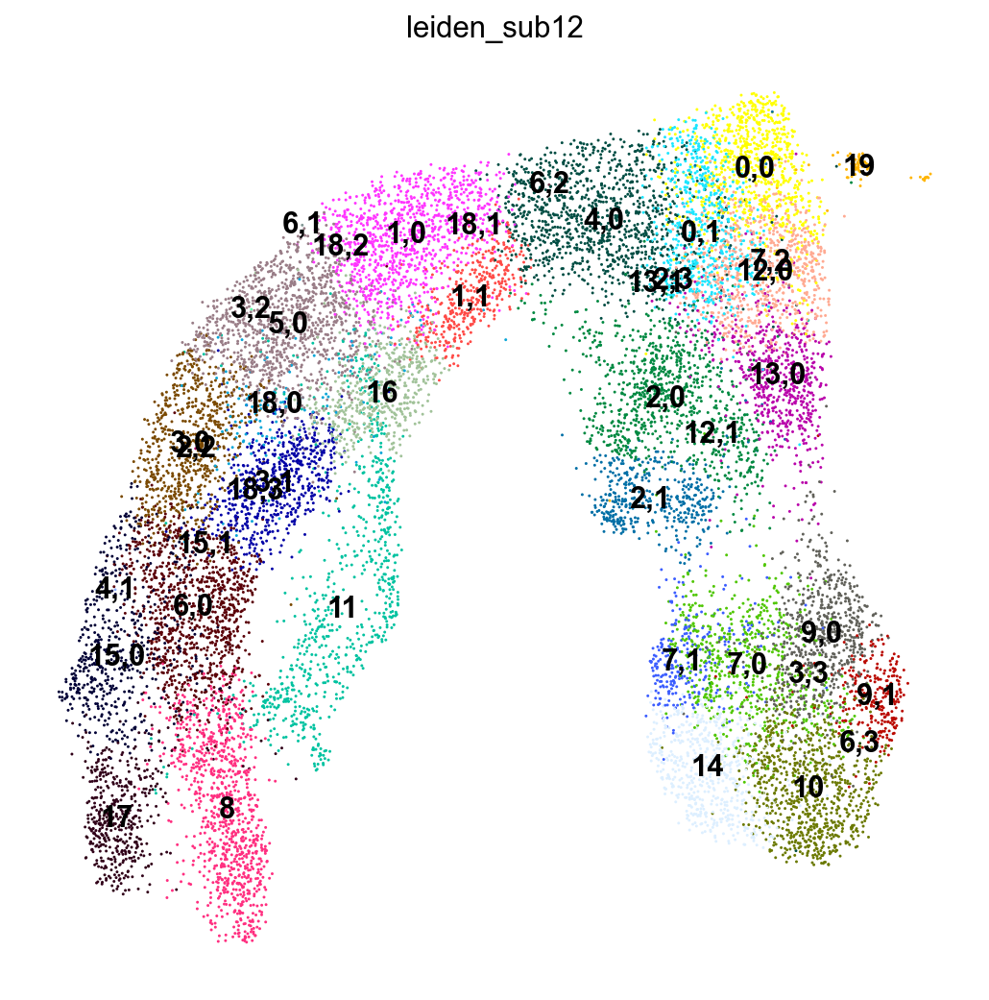

4,0     1161
5,0     1157
6,0     1017
1,0     1014
8        934
2,0      911
0,0      868
10       829
11       762
3,0      714
12,0     709
7,0      650
9,0      649
13,0     634
3,1      621
0,1      616
14       574
15,0     554
16       501
17       469
2,1      447
1,1      407
7,1      283
9,1      267
18,0     146
19        69
18,3       1
18,2       1
18,1       1
2,2        1
2,3        1
15,1       1
7,2        1
3,3        1
13,1       1
4,1        1
12,1       1
6,1        1
6,2        1
6,3        1
3,2        1
Name: leiden_sub12, dtype: int64

In [28]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub12']`
categories: 0,0, 0,1, 1,0, etc.
var_group_labels: Ngn3 High early, Ngn3 High late


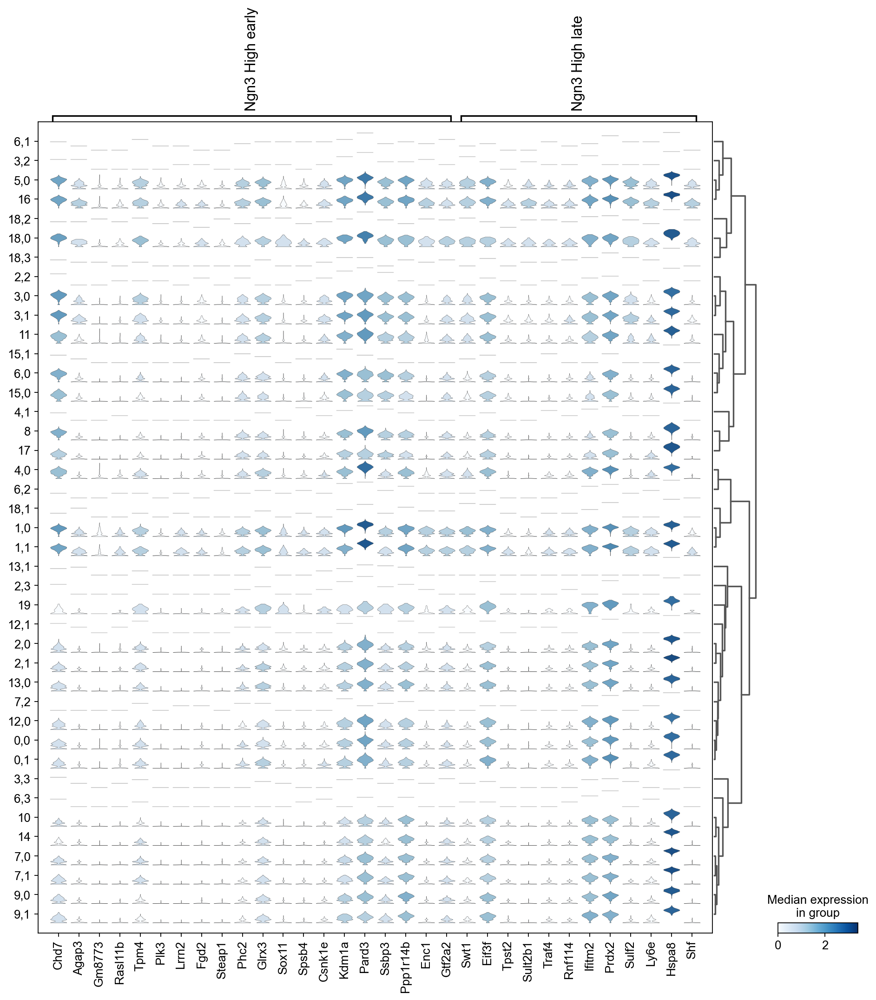

In [29]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Ngn3 High early', 'Ngn3 High late']
}, groupby=new_key, dendrogram=True)

In [30]:
adata[adata.obs["leiden"]=="18"].obs["proliferation"].value_counts()

Cycling        148
Non-Cycling      1
Name: proliferation, dtype: int64

In [31]:
adata[adata.obs[new_key]=="18,0"].obs["proliferation"].value_counts()

Cycling    146
Name: proliferation, dtype: int64

- 18,0: Ngn3 high cycling
- 18,1: low 
- 18,2: low 
- 18,3: low 



Subcluster 11

In [32]:
c_id = 11

In [33]:
init_clus_dict[str(c_id)]

['Fev+ Delta', 'Fev+ Epsilon', 'Epsilon', 'Delta']

In [34]:
orig_key = 'leiden_sub12'
new_key = 'leiden_sub13' 
new_rg_key = 'rg_sub13'
sub_key = str(c_id)

running Leiden clustering
    finished: found 47 clusters and added
    'leiden_sub13', the cluster labels (adata.obs, categorical) (0:00:00)


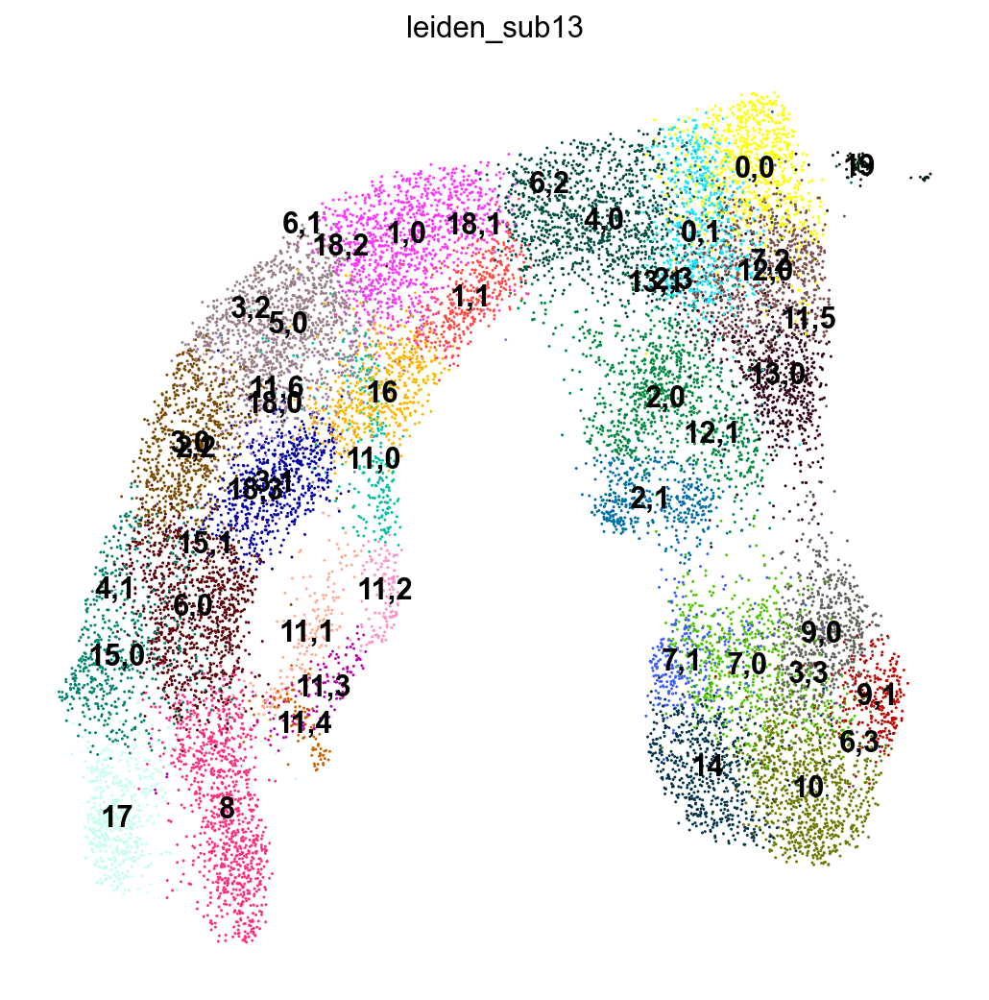

4,0     1161
5,0     1157
6,0     1017
1,0     1014
8        934
2,0      911
0,0      868
10       829
3,0      714
12,0     709
7,0      650
9,0      649
13,0     634
3,1      621
0,1      616
14       574
15,0     554
16       501
17       469
2,1      447
1,1      407
7,1      283
9,1      267
11,0     242
11,1     190
18,0     146
11,2     123
11,3     120
11,4      85
19        69
4,1        1
15,1       1
18,3       1
18,2       1
18,1       1
3,2        1
6,1        1
6,2        1
6,3        1
11,5       1
2,3        1
13,1       1
7,2        1
12,1       1
2,2        1
11,6       1
3,3        1
Name: leiden_sub13, dtype: int64

In [35]:
res=0.5
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

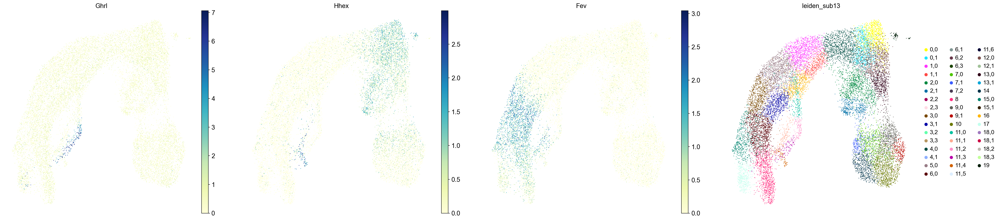

In [36]:
sc.pl.umap(adata, color=["Ghrl", "Hhex", "Fev", new_key])

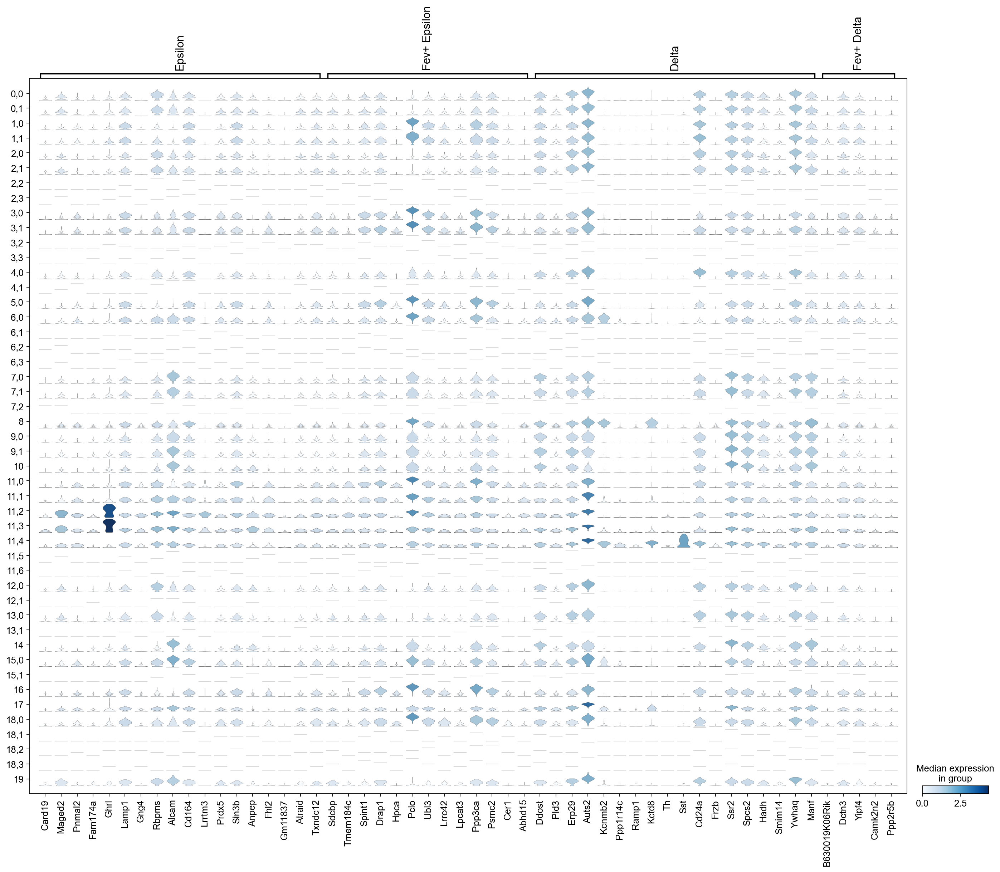

In [37]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Epsilon', 'Fev+ Epsilon', 'Delta', 'Fev+ Delta']
}, groupby=new_key)

- 11,0: Eps/Delta progenitor
- 11,1: Fev+ Delta
- 11,2: Epsilon
- 11,3: Epsilon
- 11,4: Delta
- 11,5: low q
- 11,6: low q

Cluster 8

In [38]:
c_id = 8

In [39]:
init_clus_dict[str(c_id)]

['Beta', 'Fev+ Beta']

In [40]:
orig_key = 'leiden_sub13'
new_key = 'leiden_sub14' 
new_rg_key = 'rg_sub14'
sub_key = str(c_id)

running Leiden clustering
    finished: found 48 clusters and added
    'leiden_sub14', the cluster labels (adata.obs, categorical) (0:00:00)


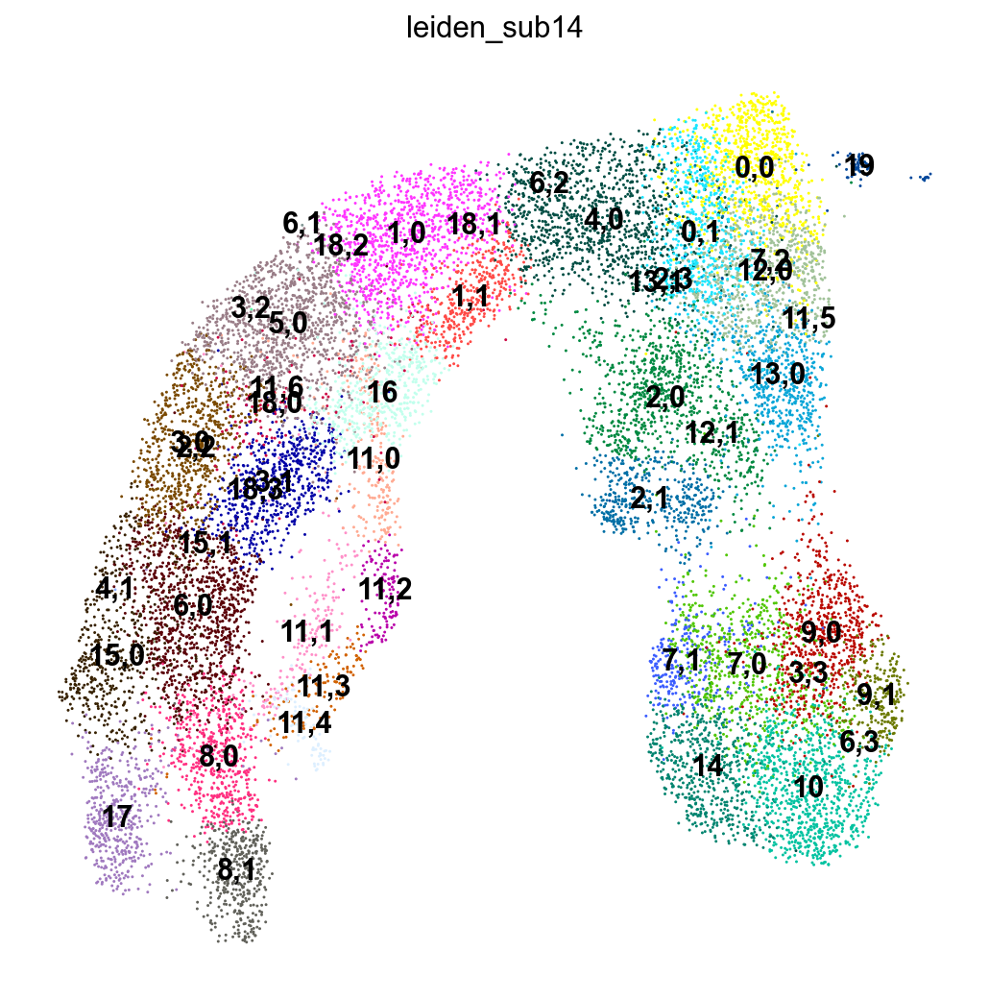

4,0     1161
5,0     1157
6,0     1017
1,0     1014
2,0      911
0,0      868
10       829
3,0      714
12,0     709
7,0      650
9,0      649
13,0     634
3,1      621
0,1      616
14       574
15,0     554
8,0      519
16       501
17       469
2,1      447
8,1      415
1,1      407
7,1      283
9,1      267
11,0     242
11,1     190
18,0     146
11,2     123
11,3     120
11,4      85
19        69
3,2        1
15,1       1
18,3       1
18,2       1
18,1       1
4,1        1
2,3        1
6,1        1
6,2        1
11,5       1
6,3        1
13,1       1
2,2        1
12,1       1
7,2        1
11,6       1
3,3        1
Name: leiden_sub14, dtype: int64

In [41]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub14']`
categories: 0,0, 0,1, 1,0, etc.
var_group_labels: Fev+ Beta, Beta


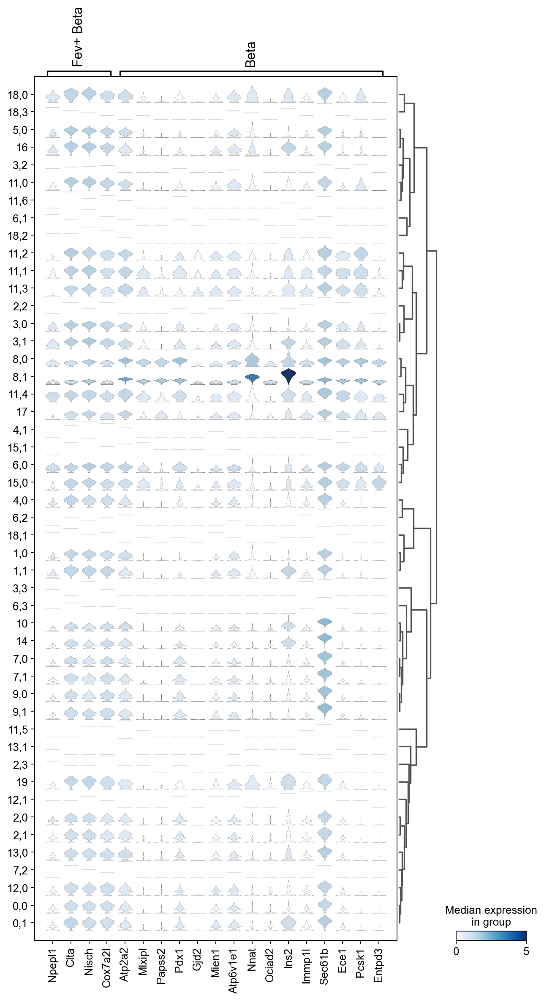

In [42]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Fev+ Beta', 'Beta']
}, groupby=new_key, dendrogram=True)

- 8,0: Fev+ Beta
- 8,1: Beta



Subcluster 14

In [43]:
c_id = 14

In [44]:
init_clus_dict[str(c_id)]

['Prlf. Acinar', 'Mat. Acinar']

In [45]:
orig_key = 'leiden_sub14'
new_key = 'leiden_sub15' 
new_rg_key = 'rg_sub15'
sub_key = str(c_id)

running Leiden clustering
    finished: found 51 clusters and added
    'leiden_sub15', the cluster labels (adata.obs, categorical) (0:00:00)


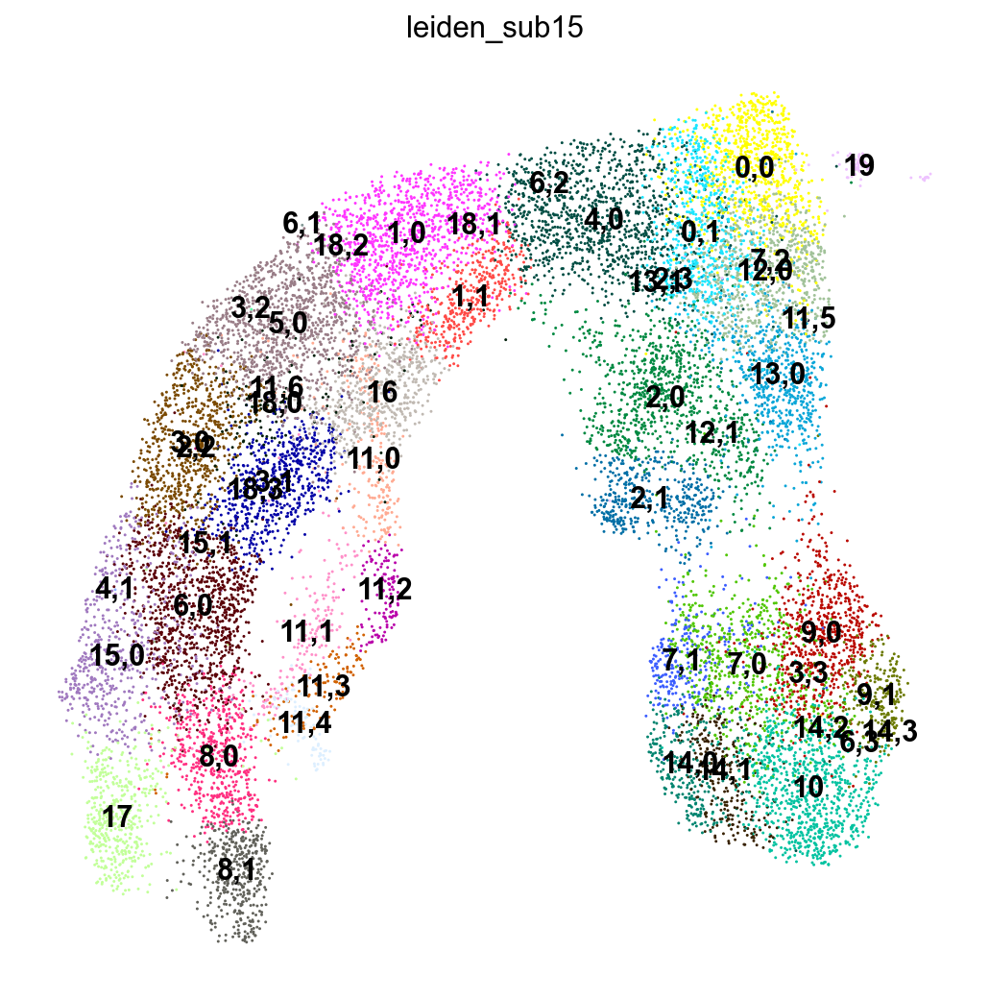

4,0     1161
5,0     1157
6,0     1017
1,0     1014
2,0      911
0,0      868
10       829
3,0      714
12,0     709
7,0      650
9,0      649
13,0     634
3,1      621
0,1      616
15,0     554
8,0      519
16       501
17       469
2,1      447
8,1      415
1,1      407
14,0     298
7,1      283
14,1     273
9,1      267
11,0     242
11,1     190
18,0     146
11,2     123
11,3     120
11,4      85
19        69
14,2       2
14,3       1
18,3       1
18,2       1
18,1       1
2,2        1
2,3        1
15,1       1
3,2        1
7,2        1
3,3        1
6,3        1
13,1       1
6,1        1
12,1       1
6,2        1
11,6       1
11,5       1
4,1        1
Name: leiden_sub15, dtype: int64

In [46]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub15']`
categories: 0,0, 0,1, 1,0, etc.
var_group_labels: Prlf. Acinar, Mat. Acinar


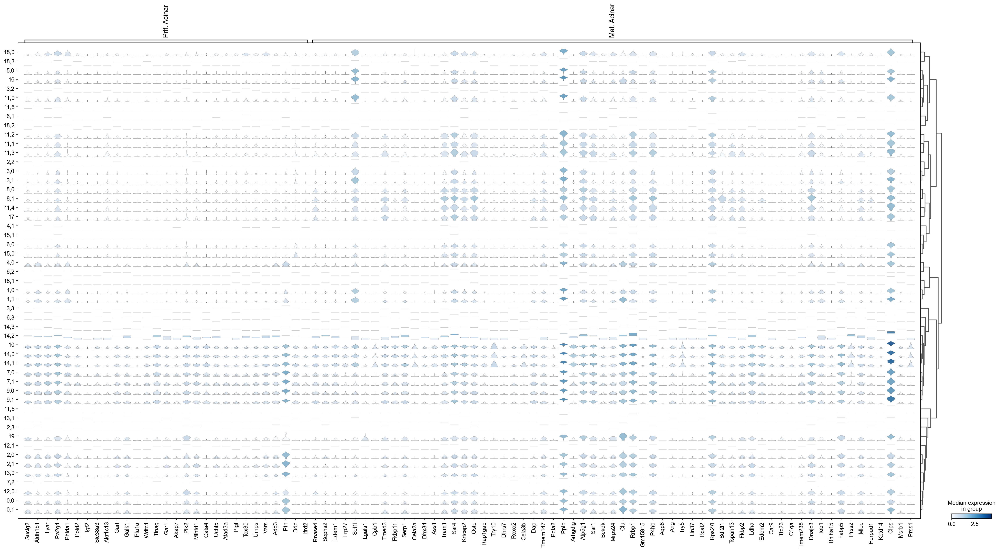

In [47]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Prlf. Acinar', 'Mat. Acinar']
}, groupby=new_key, dendrogram=True)

- 14,0: Mature Acinar
- 14,1: Mature Acinar
- 14,2: low q
- 14,3: low q

Cluster 10

In [48]:
c_id = 10

In [49]:
init_clus_dict[str(c_id)]

['Prlf. Acinar', 'Mat. Acinar']

In [50]:
orig_key = 'leiden_sub15'
new_key = 'leiden_sub16' 
new_rg_key = 'rg_sub16'
sub_key = str(c_id)

running Leiden clustering
    finished: found 52 clusters and added
    'leiden_sub16', the cluster labels (adata.obs, categorical) (0:00:00)


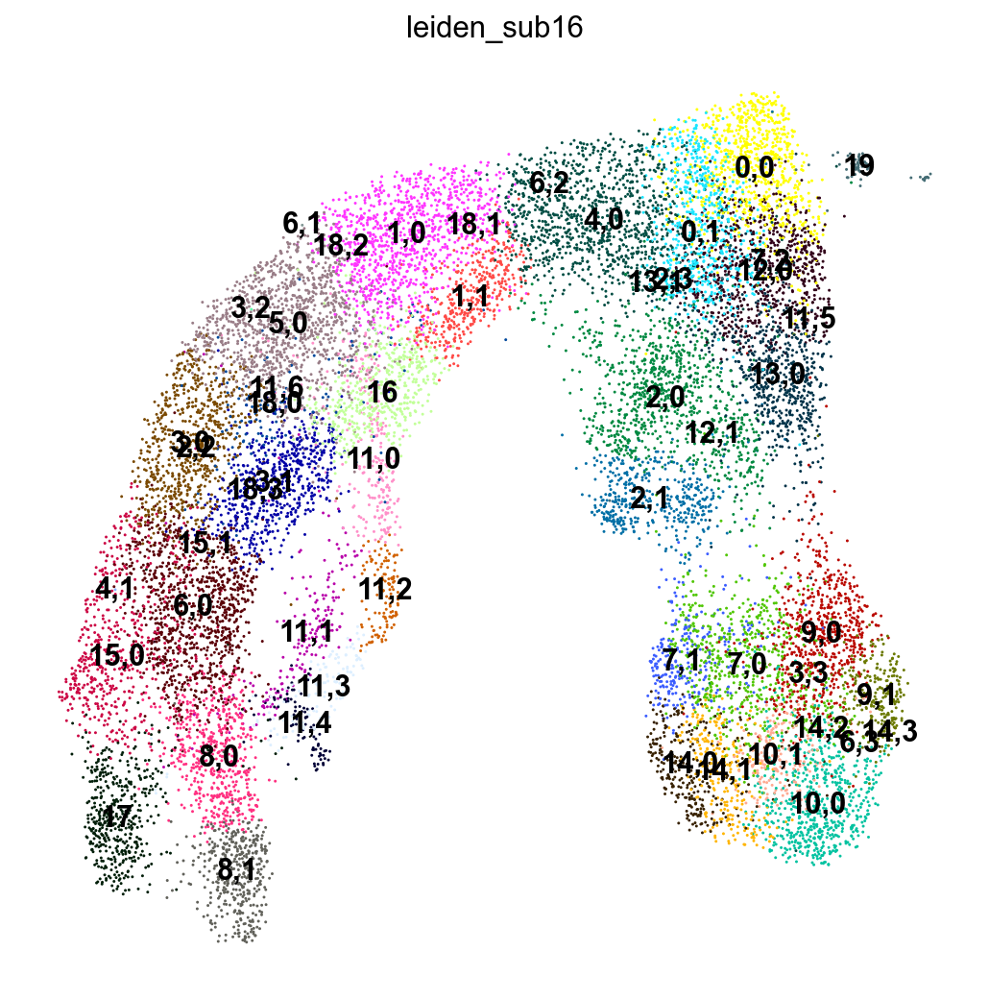

4,0     1161
5,0     1157
6,0     1017
1,0     1014
2,0      911
0,0      868
3,0      714
12,0     709
7,0      650
9,0      649
13,0     634
3,1      621
0,1      616
10,0     613
15,0     554
8,0      519
16       501
17       469
2,1      447
8,1      415
1,1      407
14,0     298
7,1      283
14,1     273
9,1      267
11,0     242
10,1     216
11,1     190
18,0     146
11,2     123
11,3     120
11,4      85
19        69
14,2       2
18,1       1
14,3       1
18,2       1
18,3       1
15,1       1
4,1        1
13,1       1
12,1       1
11,6       1
3,3        1
2,2        1
2,3        1
7,2        1
3,2        1
6,3        1
6,2        1
6,1        1
11,5       1
Name: leiden_sub16, dtype: int64

In [51]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub16']`
categories: 0,0, 0,1, 1,0, etc.
var_group_labels: Prlf. Acinar, Mat. Acinar


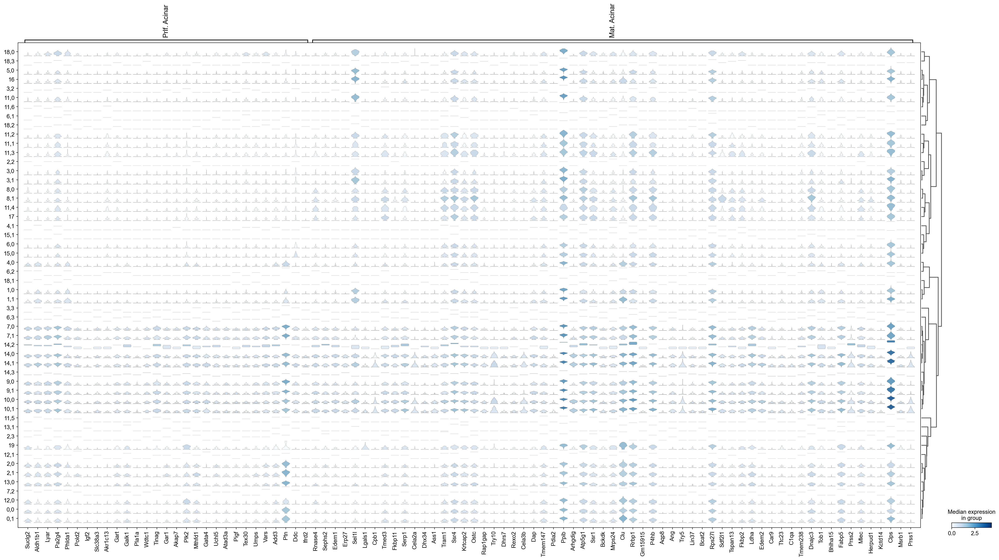

In [52]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Prlf. Acinar', 'Mat. Acinar']
}, groupby=new_key, dendrogram=True)

- 10,0: Mat. Acinar
- 10,1: Mat. Acinar

Cluster 19

In [53]:
c_id = 19

In [54]:
init_clus_dict[str(c_id)]

['Ductal', 'Prlf. Ductal']

In [55]:
orig_key = 'leiden_sub16'
new_key = 'leiden_sub17' 
new_rg_key = 'rg_sub17'
sub_key = str(c_id)

running Leiden clustering
    finished: found 54 clusters and added
    'leiden_sub17', the cluster labels (adata.obs, categorical) (0:00:00)


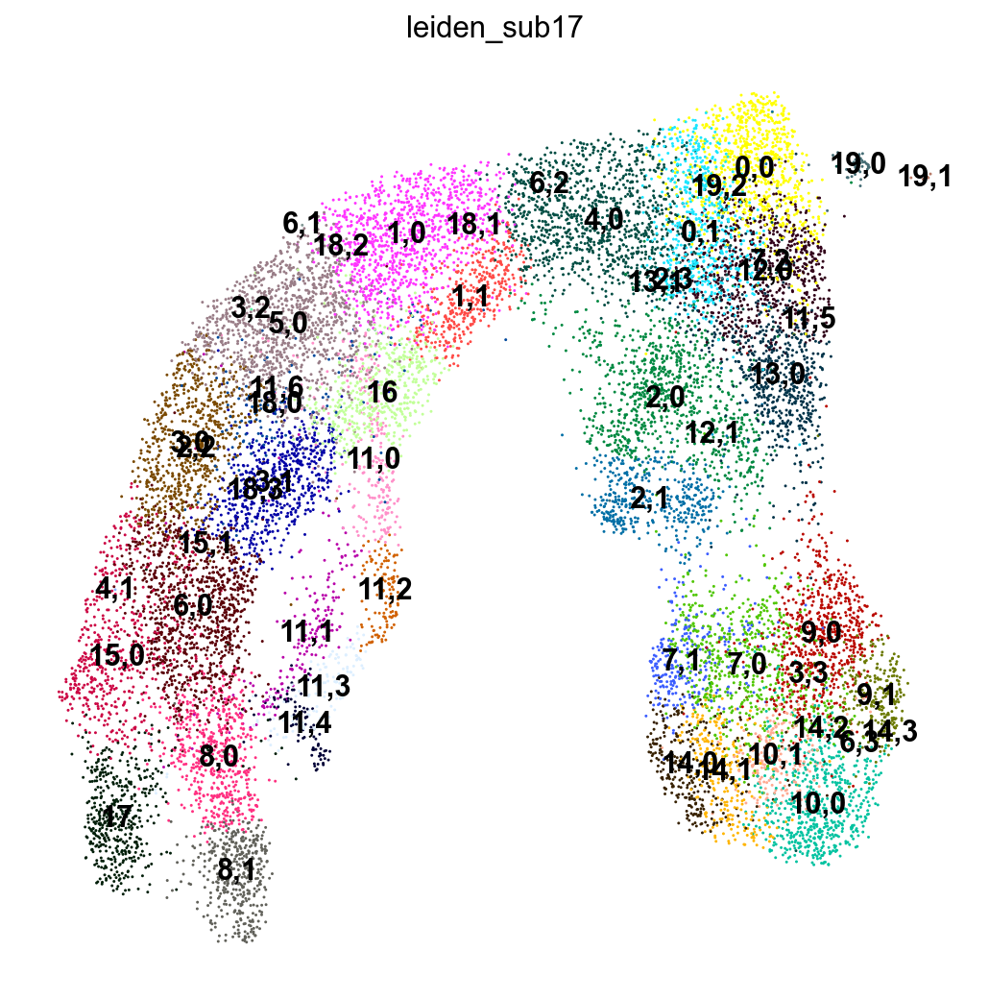

4,0     1161
5,0     1157
6,0     1017
1,0     1014
2,0      911
0,0      868
3,0      714
12,0     709
7,0      650
9,0      649
13,0     634
3,1      621
0,1      616
10,0     613
15,0     554
8,0      519
16       501
17       469
2,1      447
8,1      415
1,1      407
14,0     298
7,1      283
14,1     273
9,1      267
11,0     242
10,1     216
11,1     190
18,0     146
11,2     123
11,3     120
11,4      85
19,0      55
19,1      13
14,2       2
7,2        1
3,2        1
18,3       1
18,2       1
18,1       1
2,2        1
2,3        1
15,1       1
3,3        1
14,3       1
6,3        1
4,1        1
13,1       1
6,1        1
12,1       1
6,2        1
11,6       1
11,5       1
19,2       1
Name: leiden_sub17, dtype: int64

In [56]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub17']`
categories: 0,0, 0,1, 1,0, etc.
var_group_labels: Ductal, Prlf. Ductal


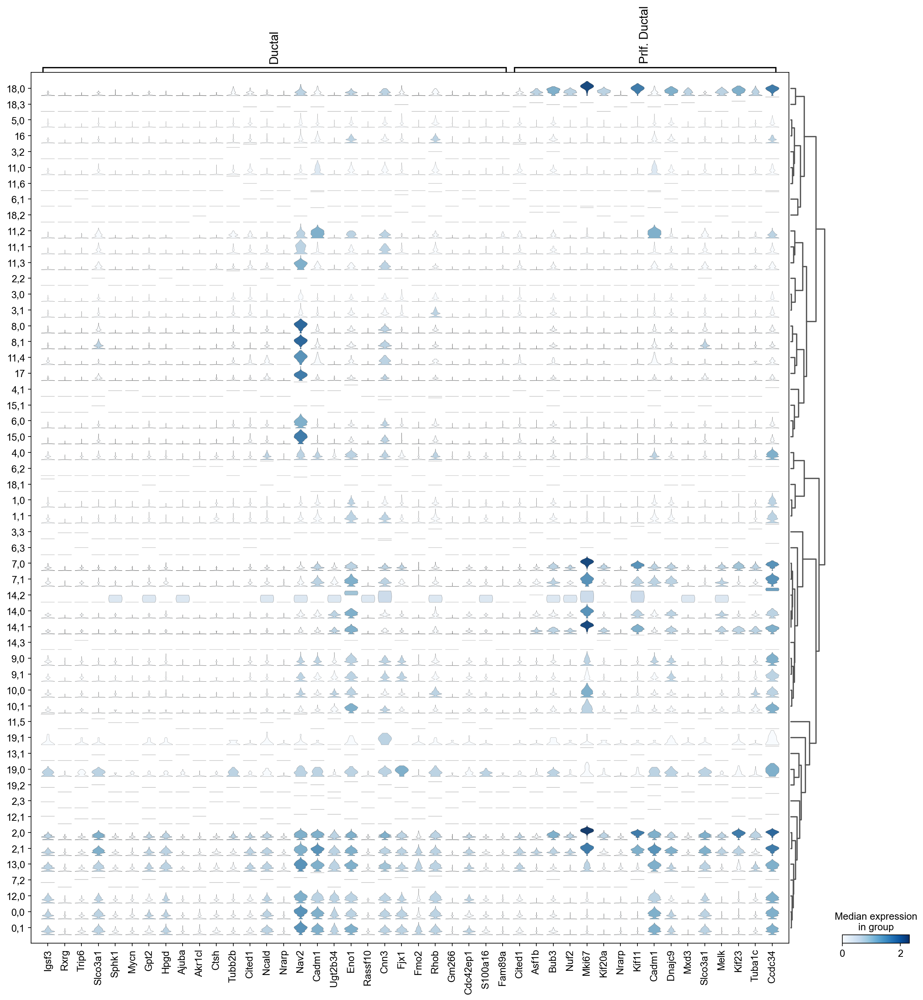

In [57]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Ductal', 'Prlf. Ductal']
}, groupby=new_key, dendrogram=True)

In [58]:
adata[adata.obs[new_key]=="19,0"].obs["doublet_calls"].value_counts()

0    34
1    16
2     3
3     2
Name: doublet_calls, dtype: int64

In [59]:
adata[adata.obs[new_key]=="19,1"].obs["doublet_calls"].value_counts()

0    7
1    5
2    1
Name: doublet_calls, dtype: int64

In [60]:
adata[adata.obs[new_key]=="19,0"].obs["proliferation"].value_counts()

Non-Cycling    28
Cycling        27
Name: proliferation, dtype: int64

In [61]:
adata[adata.obs[new_key]=="19,1"].obs["proliferation"].value_counts()

Non-Cycling    12
Cycling         1
Name: proliferation, dtype: int64

In [62]:
adata[adata.obs[new_key]=="19,0"].obs["sample"].value_counts()

E15.5    41
E14.5    14
Name: sample, dtype: int64

In [63]:
adata[adata.obs[new_key]=="19,1"].obs["sample"].value_counts()

E14.5    7
E15.5    6
Name: sample, dtype: int64

- 19,0 Ductal
- 19,1 Ductal
- 19,2 low q

Cluster 16

In [64]:
c_id = 16

In [65]:
init_clus_dict[str(c_id)]

['Ngn3 High cycling', 'Ngn3 High early', 'Ngn3 High late', 'Fev+']

In [66]:
orig_key = 'leiden_sub17'
new_key = 'leiden_sub18' 
new_rg_key = 'rg_sub18'
sub_key = str(c_id)

running Leiden clustering
    finished: found 57 clusters and added
    'leiden_sub18', the cluster labels (adata.obs, categorical) (0:00:00)


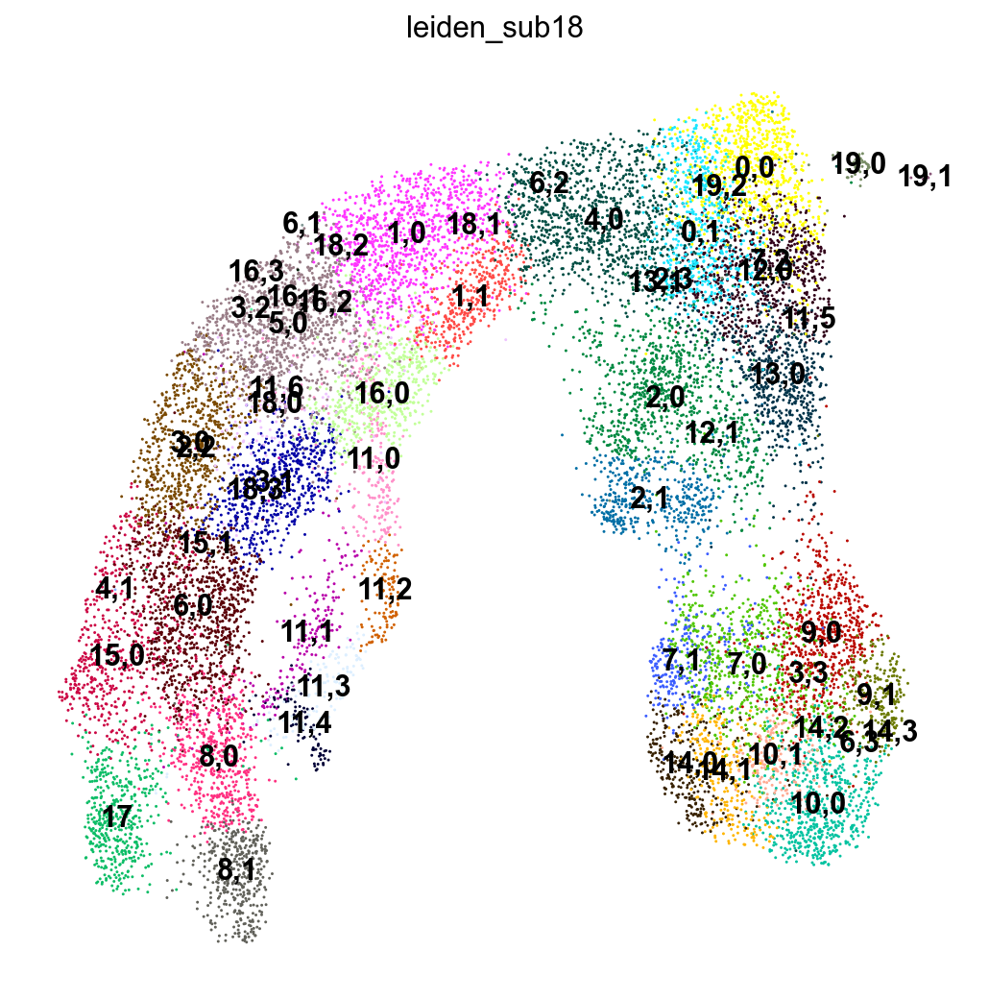

4,0     1161
5,0     1157
6,0     1017
1,0     1014
2,0      911
0,0      868
3,0      714
12,0     709
7,0      650
9,0      649
13,0     634
3,1      621
0,1      616
10,0     613
15,0     554
8,0      519
16,0     497
17       469
2,1      447
8,1      415
1,1      407
14,0     298
7,1      283
14,1     273
9,1      267
11,0     242
10,1     216
11,1     190
18,0     146
11,2     123
11,3     120
11,4      85
19,0      55
19,1      13
14,2       2
16,1       2
16,3       1
16,2       1
18,2       1
2,2        1
18,1       1
15,1       1
18,3       1
2,3        1
7,2        1
3,2        1
14,3       1
3,3        1
4,1        1
13,1       1
6,1        1
12,1       1
6,2        1
11,6       1
11,5       1
6,3        1
19,2       1
Name: leiden_sub18, dtype: int64

In [67]:
res=0.2
sc.tl.leiden(adata, restrict_to=(orig_key, [sub_key]), key_added=new_key, resolution=res)
sc.pl.umap(adata, color=new_key, legend_loc='on data')
adata.obs[new_key].value_counts()

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_sub18']`
categories: 0,0, 0,1, 1,0, etc.
var_group_labels: Ngn3 High late


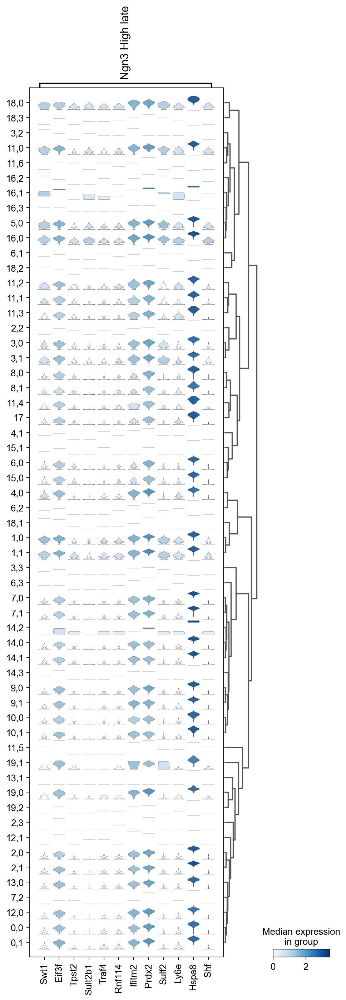

In [68]:
sc.pl.stacked_violin(adata, var_names={a:set(marker_genes_mouse2[a]).intersection(adata.var.index) for a in ['Ngn3 High late']
}, groupby=new_key, dendrogram=True)

- 16,0: Ngn3 high late
- 16,1: low q
- 16,2: low q
- 16,3: low q

In [69]:
final_leiden = "leiden_sub18"

In [70]:
# note: Multipotent annotations are immature Acinar cells
# note: we do not distinguish between Ngn3 high late and Ngn3 high early

new_cluster_names = {
    "12,0": "Ductal",
    "12,1": "low q",
    
    "13,0": "Ductal",
    "13,1": "low q",
    
    "15,0": "Fev+ Alpha",
    "15,1": "low q",

    "18,0": "Ngn3 high cycling",
    "18,1": "low q",
    "18,2": "low q",
    "18,3": "low q",

    "11,0": "Eps/Delta progenitors",
    "11,1": "Fev+ Delta",
    "11,2": "Epsilon",
    "11,3": "Epsilon",
    "11,4": "Delta",
    "11,5": "low q",
    "11,6": "low q",

    "8,0": "Fev+ Beta",
    "8,1": "Beta",
    
    "14,0": "Mat. Acinar",
    "14,1": "Mat. Acinar",
    "14,2": "low q",
    "14,3": "low q",
    
    "10,0": "Mat. Acinar",
    "10,1": "Mat. Acinar",
    
    "19,0": "Ductal",
    "19,1": "Ductal",
    "19,2": "low q",

    "0,0": "Ductal",
    "0,1": "Ductal",

    "1,0": "Ngn3 high",
    "1,1": "Ngn3 high",
    
    "2,0": "Prlf. Ductal",
    "2,1": "Prlf. Ductal",
    "2,2": "low q",
    "2,3": "low q",
    
    "3,0": "Fev+",
    "3,1": "Fev+",
    "3,2": "low q",
    "3,3": "low q",
    
    "4,0": "Ngn3 low EP",
    "4,1": "low q",
    
    "6,0": "Fev+ Beta",
    "6,1": "low q",
    "6,2": "low q",
    "6,3": "low q",

    "7,0": "Imm. Acinar",
    "7,1": "Imm. Acinar",
    "7,2": "low q",
    
    "9,0": "Imm. Acinar",
    "9,1": "Imm. Acinar",
    
    "5,0": "Ngn3 high",
    
    "17": "Alpha",
    
    "16,0": "Ngn3 high",
    "16,1": "low q",
    "16,2": "low q",
    "16,3": "low q",




    
}
ct_column = 'celltype'
adata.obs[ct_column] = adata.obs[final_leiden].astype("str").values
for key in new_cluster_names.keys():
    adata.obs[ct_column][adata.obs[final_leiden]==key] = new_cluster_names[key]
adata.obs[ct_column] = adata.obs[ct_column].astype("category")
#adata.obs.celltype = adata.obs.celltype.cat.rename_categories(new_cluster_names)

/var/folders/nv/23yzkl2x1gd0mhpjqgpm0f4hqc8gvy/T/ipykernel_41636/2520195211.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs[ct_column][adata.obs[final_leiden]==key] = new_cluster_names[key]
/var/folders/nv/23yzkl2x1gd0mhpjqgpm0f4hqc8gvy/T/ipykernel_41636/2520195211.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs[ct_column][adata.obs[final_leiden]==key] = new_cluster_names[key]
/var/folders/nv/23yzkl2x1gd0mhpjqgpm0f4hqc8gvy/T/ipykernel_41636/2520195211.py:90: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: htt

In [71]:
[key for key in marker_genes_mouse2.keys() if key in adata.obs[ct_column].cat.categories]

['Mat. Acinar',
 'Ductal',
 'Prlf. Ductal',
 'Ngn3 low EP',
 'Fev+ Beta',
 'Beta',
 'Fev+ Alpha',
 'Alpha',
 'Fev+ Delta',
 'Delta',
 'Epsilon']

In [72]:
set(adata.obs[ct_column].cat.categories).difference(set([key for key in marker_genes_mouse2.keys() if key in adata.obs[ct_column].cat.categories]))

{'Eps/Delta progenitors',
 'Fev+',
 'Imm. Acinar',
 'Ngn3 high',
 'Ngn3 high cycling',
 'low q'}

In [73]:
adata.obs["celltype"].value_counts()

Ngn3 high                3075
Ductal                   2895
Imm. Acinar              1849
Fev+ Beta                1536
Mat. Acinar              1400
Prlf. Ductal             1358
Fev+                     1335
Ngn3 low EP              1161
Fev+ Alpha                554
Alpha                     469
Beta                      415
Epsilon                   243
Eps/Delta progenitors     242
Fev+ Delta                190
Ngn3 high cycling         146
Delta                      85
low q                      25
Name: celltype, dtype: int64

In [74]:
adata = adata[~(adata.obs["celltype"] == "low q")]

/Users/dominik.klein/opt/anaconda3/envs/mm_best_muon_full/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/Users/dominik.klein/opt/anaconda3/envs/mm_best_muon_full/lib/python3.9/contextlib.py:126: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  next(self.gen)


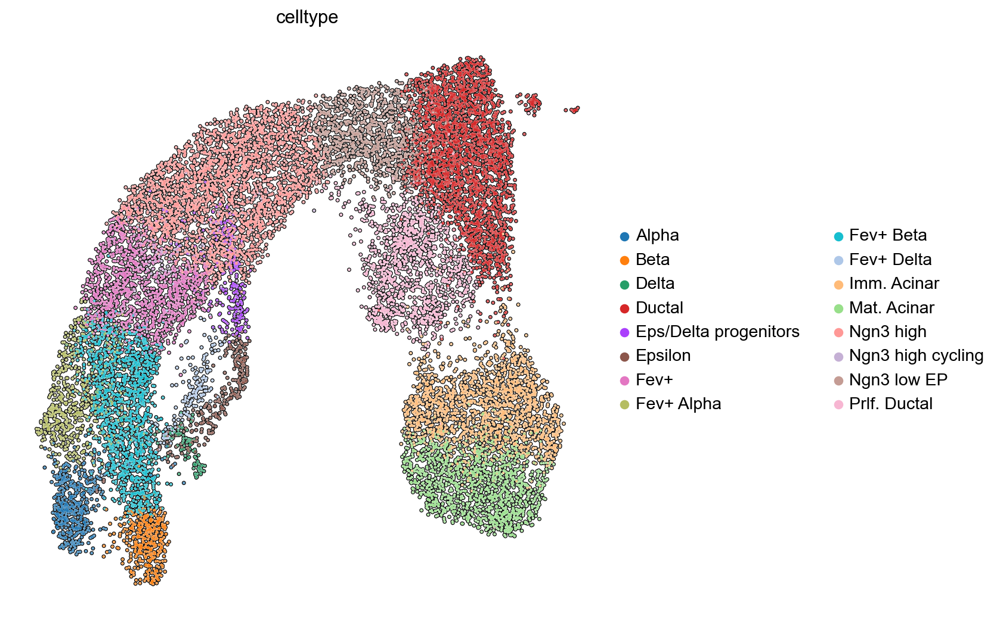

In [75]:
sc.pl.umap(adata, color=ct_column, size=15, add_outline=True, alpha=0.7, outline_width=(0.3, 0.0), color_map=ch_YlRd)

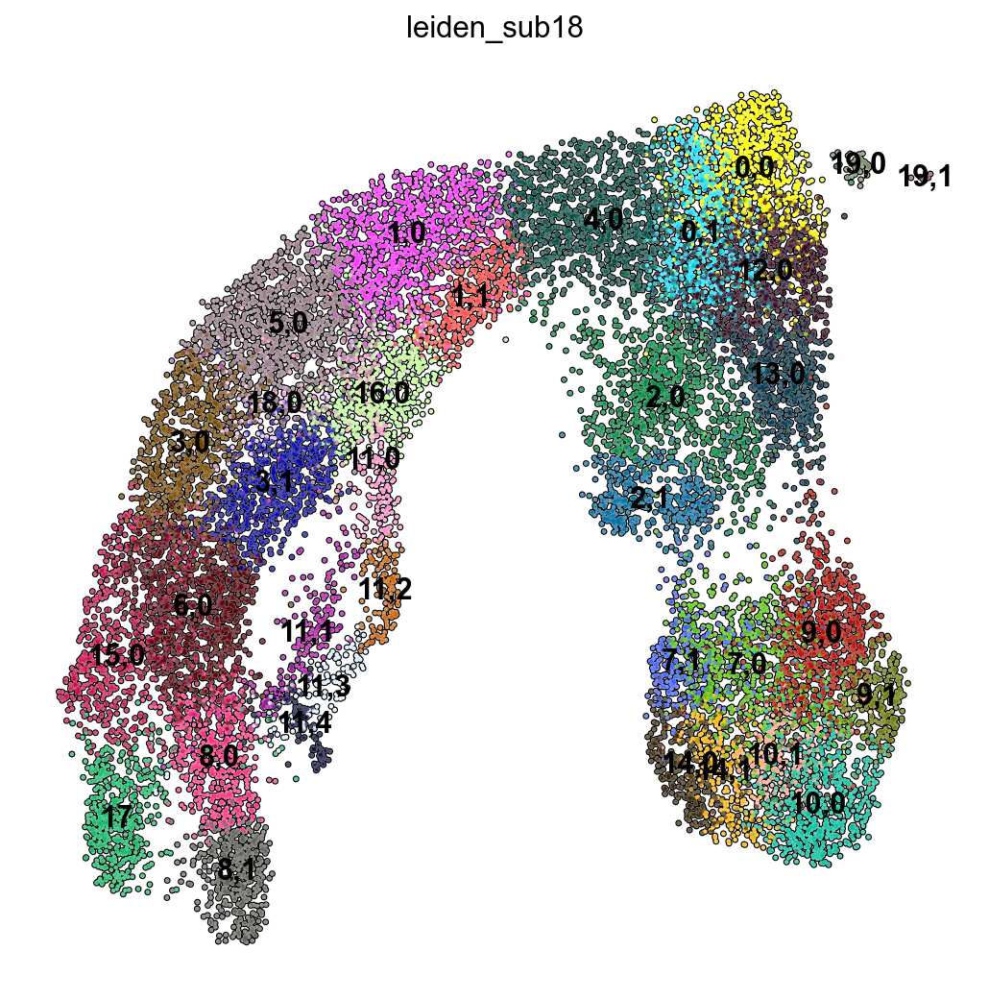

In [76]:
sc.pl.umap(adata, color=final_leiden, legend_loc="on data", size=15, add_outline=True, alpha=0.7, outline_width=(0.3, 0.0), color_map=ch_YlRd)

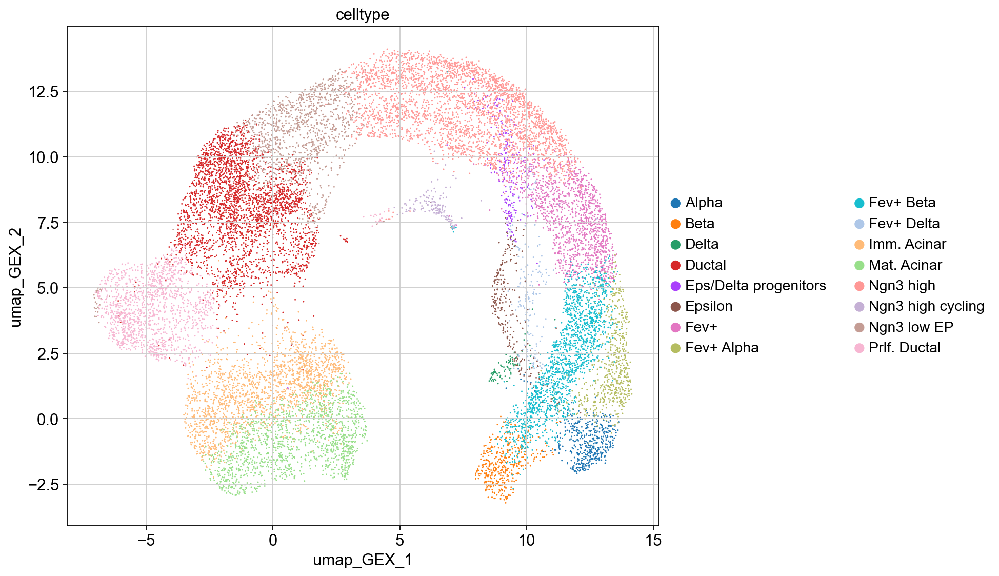

In [77]:
sc.pl.scatter(adata, x="umap_GEX_1", y="umap_GEX_2", color=ct_column)

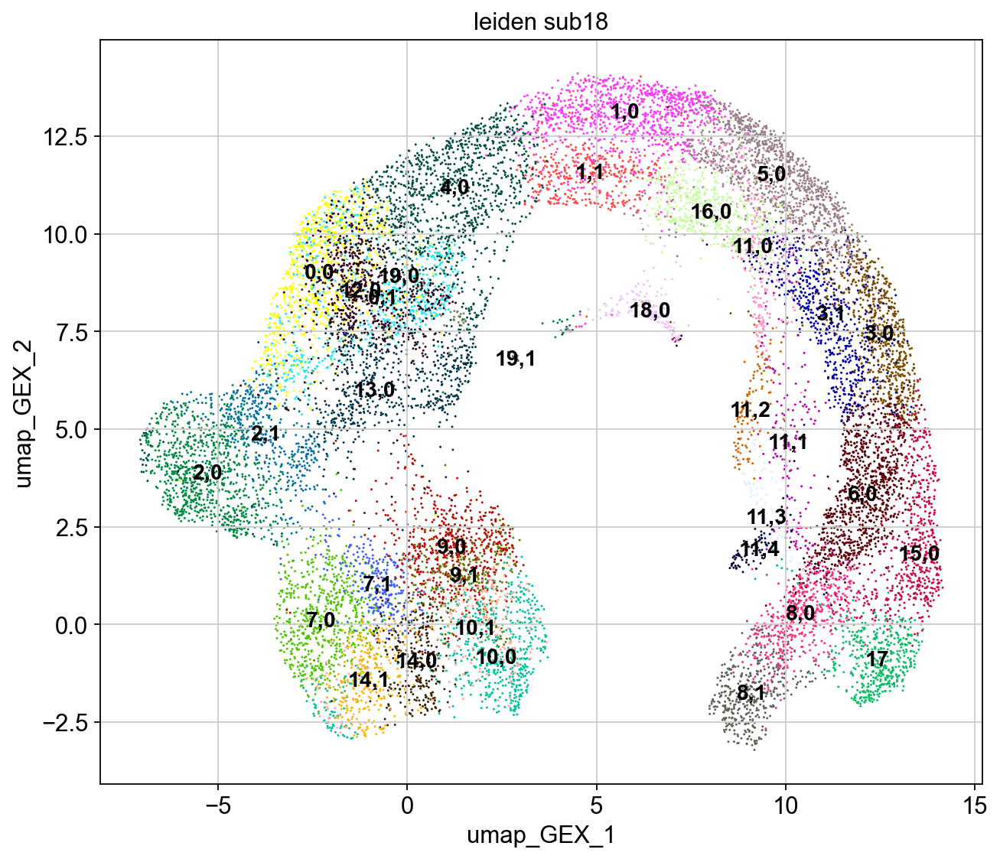

In [78]:
sc.pl.scatter(adata, x="umap_GEX_1", y="umap_GEX_2", color=final_leiden, legend_loc="on data")

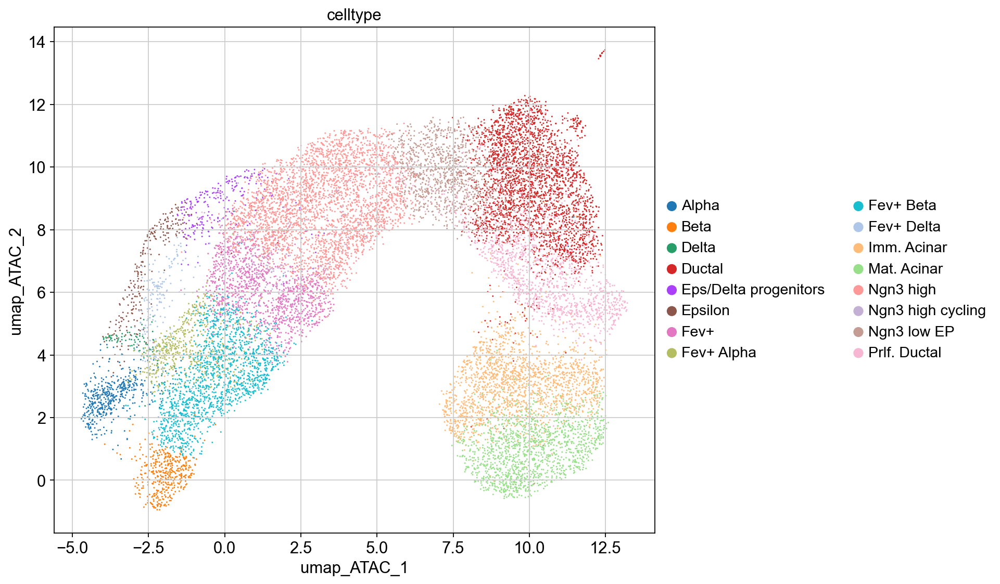

In [79]:
sc.pl.scatter(adata, x="umap_ATAC_1", y="umap_ATAC_2", color=ct_column)

In [80]:
x,y = 'sample', 'celltype'
df = adata.obs.copy()
df1 = df.groupby(x)[y].value_counts(normalize=True)
df1 = df1.mul(100)
df1 = df1.rename('percent').reset_index()

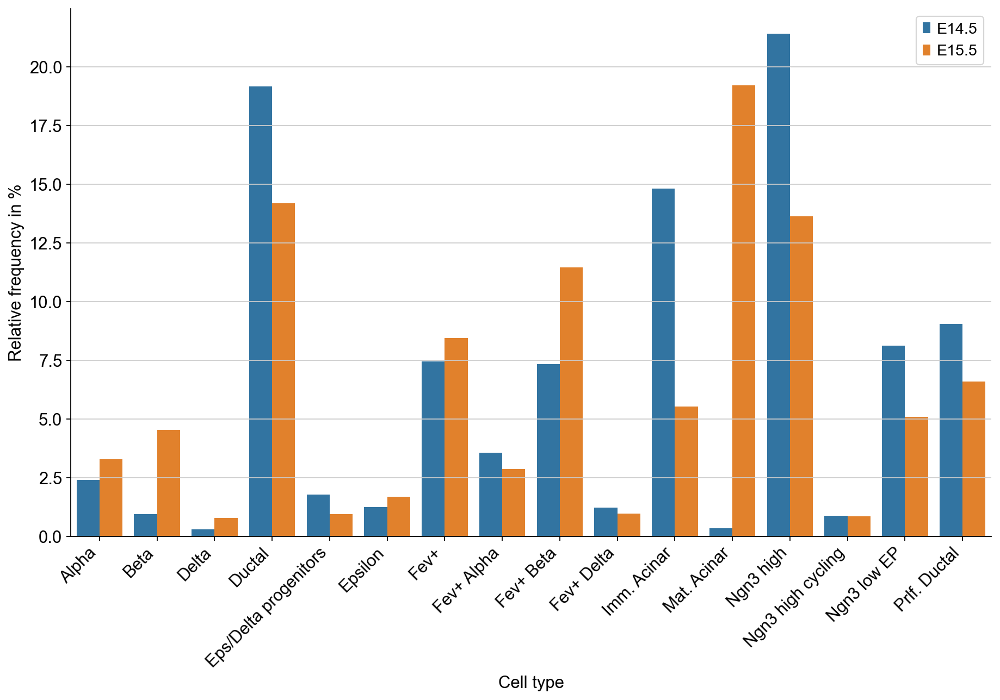

In [81]:
import seaborn as sns

g = sns.catplot(x="level_1",y='percent',hue=x,kind='bar',data=df1, legend=False,height=8.27, aspect=11.7/8.27)
plt.xlabel("Cell type")
plt.ylabel("Relative frequency in %")
plt.xticks(rotation=45, ha='right')
plt.legend(loc='upper right')
plt.tight_layout()


In [84]:
x,y = 'sample', 'celltype'
df2 = adata[~adata.obs["celltype"].isin(["Mat. Acinar", "Imm. Acinar", "Ductal", "Prlf. Ductal"])].obs.copy()
df3 = df2.groupby(x)[y].value_counts(normalize=True)
df3 = df3.mul(100)
df3 = df3.rename('percent').reset_index()

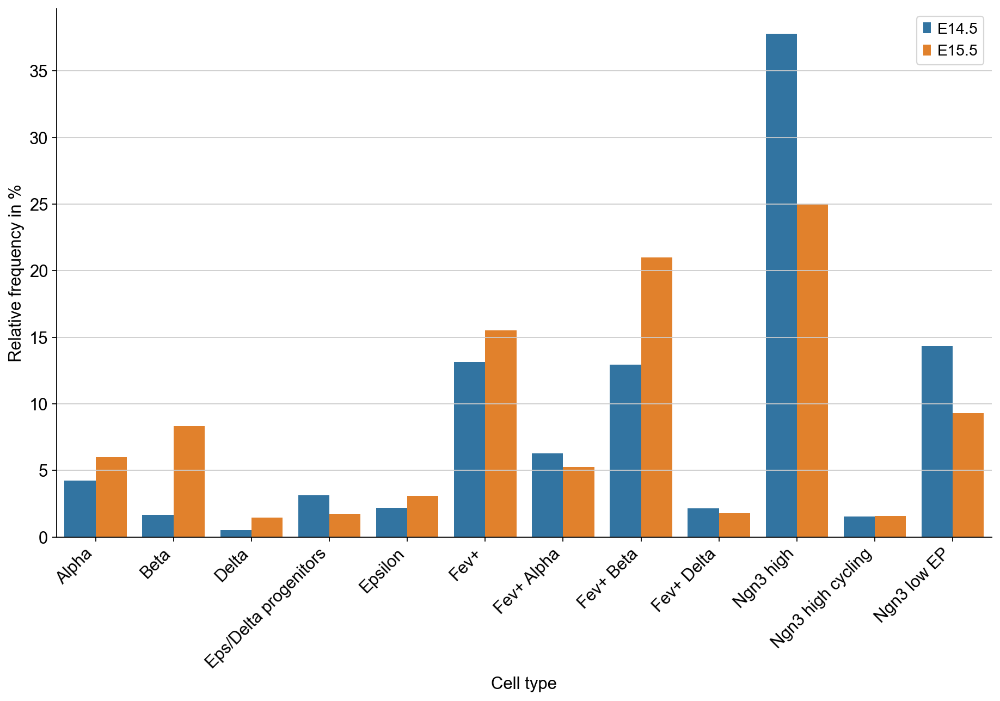

In [85]:
g = sns.catplot(x="level_1",y='percent',hue=x,kind='bar',data=df3, legend=False,height=8.27, aspect=11.7/8.27)
plt.xlabel("Cell type")
plt.ylabel("Relative frequency in %")
plt.xticks(rotation=45, ha='right')
plt.legend(loc='upper right')
plt.tight_layout()

In [86]:
adata.obsm["X_umap_ATAC"] = adata.obsm["umap_ATAC"]
adata.obsm["X_umap_GEX"] = adata.obsm["umap_GEX"]

In [87]:
adata

AnnData object with n_obs × n_vars = 16953 × 14663
    obs: 'n_counts', 'sample', 'int_id', 'reporter', 'log_cell_probs', 'cell_barcodes_du', 'cell_barcodes_cr', 'cell_barcodes', 'log_counts', 'n_genes', 'log_genes', 'mt_frac', 'rp_frac', 'ambi_frac', 'total_counts_rank', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'leiden', 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS.enrichment', 'TSS.percentile', 'log_nCount_ATAC', 'log_nFeature_ATAC', 'scrublet_scores', 'scrublet_doublets', 'scrublet_doublets_cat', 'dd_doublets', 'dd_scores', 'dd_log_p_values', 'dd_voting_average', 'dd_-log_p_values', 'dd_doublets_cat', 'pANN', 'DF_classifications_1', 'DF_classifications_2', 'pANN_SCT', 'DF_SCT_classifications_1', 'DF_SCT_classifications_2', 'df_doublets',

In [88]:
# Save
sc.write('/Users/dominik.klein/data/E14-E15_adata_filtered_rmDoublets_sctNormalized_WNN_embedded_initialAnno_new_annotation.h5ad', adata)